<a href="https://colab.research.google.com/github/ilmuneraka/fastwork-analysis/blob/main/20240705_Potensi_Freelancer_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analisis Potensi Freelancer Data di Indonesia
- Data dari fastwork.id

## Import Libraries

In [1]:
!pip3 install googletrans==3.1.0a0

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.1/55.1 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 21.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.6/53.6 kB 709.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.0/65.0 kB 1.5 MB/s eta 0:00:00
  Created wheel for googletrans: filename=googletrans-3.1.0a0-py3-none-any.whl size=16353 sha256=c45be22097badd0ddc97ceb6ef62b44cac2c035c3f2d4f1bd5b820271157376d
  Stored in directory: /root/.cache/pip/wheels/50/5d/3c/8477d0af4ca2b8b1308812c09f1930863caeebc762fe265a95
Successfully built googletrans
  Attempting uninstall: chardet
    Found existing installation: chardet 5.2.0
    Uninstalling 

In [2]:
!pip3 install highlight-text

In [3]:
import seaborn as sns
import requests
import time
import random
from bs4 import BeautifulSoup
import pandas as pd
import numpy as np
import pickle
import json
import warnings
import ast
from datetime import date
warnings.filterwarnings('ignore')
from googletrans import Translator
translator = Translator()

pd.set_option('display.max_columns', 500)
pd.set_option('max_colwidth', None)

In [4]:
def trans_to_en(text):
    return translator.translate(text, dest='en').text

In [5]:
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
from matplotlib import font_manager, rc
from matplotlib import rcParams
from highlight_text import ax_text, fig_text
from matplotlib.ticker import FuncFormatter

weights = ['Black', 'Bold', 'Medium', 'Regular']

for w in weights:
  # URL to the font file
  font_url = 'https://github.com/JulietaUla/Montserrat/raw/master/fonts/ttf/Montserrat-{}.ttf'.format(w)

  # Download the font file
  response = requests.get(font_url)
  font_filename = 'Montserrat-{}.ttf'.format(w)  # Save the font with a local name
  with open(font_filename, 'wb') as f:
      f.write(response.content)

  # Register the font files with Matplotlib
  font_manager.fontManager.addfont(font_filename)

for w in weights:
  # URL to the font file
  font_url = 'https://github.com/google/fonts/raw/main/ofl/poppins/Poppins-{}.ttf'.format(w)

  # Download the font file
  response = requests.get(font_url)
  font_filename = 'Poppins-{}.ttf'.format(w)  # Save the font with a local name
  with open(font_filename, 'wb') as f:
      f.write(response.content)
  # Register the font files with Matplotlib
  font_manager.fontManager.addfont(font_filename)

rcParams['font.family'] = 'Montserrat'
rcParams['font.weight'] = 'medium'

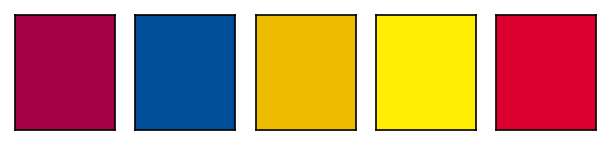

In [6]:
b_colors = ['#a50044',
            '#004d98',
            '#edbb00',
            '#ffed02',
            '#db0030']

fig, axs = plt.subplots(1, 5, figsize = (5,1), dpi=150)

for ax, color in zip(axs, b_colors):
  ax.patch.set_facecolor(color)
  ax.set_xticks([])
  ax.set_yticks([])
  # ax.set_xticklabels([])
  # ax.set_yticklabels([])
  # ax.axis('off')
plt.show()

## Import Data

### Basic Services

In [7]:
today_str = "20240503" # tanggal scraping
# with open('drive/MyDrive/Dataset/{}_{} Fastwork Services.pickle'.format(today_str, "data"), 'rb') as handle:
#     d_l_service = pickle.load(handle)

url = 'https://github.com/ilmuneraka/fastwork-analysis/raw/main/{}_{}%20Fastwork%20Services.pickle'.format(today_str, "data")

response = requests.get(url)
response.raise_for_status()  # Ensure we notice bad responses

# Load the pickle data from the response content
d_l_service = pickle.loads(response.content)

d_badges = {'pro':'https://storage.googleapis.com/fastwork-asset/product_options/badge_pro_x2.png',
 'banyak_rehire':'https://storage.googleapis.com/fastwork-asset/product_options/badge_rehire_id.png',
 'bayar_bertahap':'https://storage.googleapis.com/fastwork-asset/product_options/milestone_v2_id.png',
 'specialist':'https://storage.googleapis.com/fastwork-asset/product_options/specialist_v2_id.png'}

def clean_df(df_services, keyword):
  df_services = df_services.loc[df_services['title'].apply(lambda x:"data" in x.strip().lower().split())].reset_index(drop=True)
  df_services['user'] = df_services['url'].str.split("/").str[4]
  df_services['category'] = df_services['url'].str.split("/").str[5].str[:-9]
  df_services['price_cleaned'] = df_services['price'].str.split("\xa0").str[1].str.replace(".","").astype(int)
  df_services['sell_count_cleaned'] = df_services['sell_count'].fillna("Terjual 0").str.split(" ").str[1].astype(int)
  df_services['avg_rating'] = df_services['rating'].str.strip().str.replace("(","").str.replace(")","").str.split(" ").str[0].str.replace(",",".").astype(float)
  df_services['n_rating'] = df_services['rating'].str.strip().fillna("0 (0)").str.replace("(","").str.replace(")","").str.split(" ").str[1].astype(int)

  df_services['response_time_raw'] = df_services['response_time'].str.strip().str.split(" ").str[-2].astype(float)
  df_services['response_time_multiplier'] = 1
  df_services.loc[df_services['response_time'].fillna(" ").str.contains('jam'), 'response_time_multiplier'] = 60
  df_services.loc[df_services['response_time'].fillna(" ").str.contains('hari'), 'response_time_multiplier'] = 60*24
  df_services['response_time_cleaned'] = df_services['response_time_raw']*df_services['response_time_multiplier']

  df_services['badges'] = df_services['badges'].fillna("")
  for badge, badge_url in d_badges.items():
    df_services["badge_{}".format(badge)] = df_services.apply(lambda row: row['badges'].count(badge_url), axis=1)

  df_services_clean = df_services.copy()
  df_services_clean = df_services_clean[['url', 'user', 'category', 'image_url', 'title', 'price_cleaned', 'sell_count_cleaned', 'avg_rating', 'n_rating', 'response_time_cleaned', 'badge_pro',
       'badge_banyak_rehire', 'badge_bayar_bertahap', 'badge_specialist']].rename({'price_cleaned':'starting_price', 'sell_count_cleaned':'sell_count', 'response_time_cleaned':'response_time'},axis=1)
  return df_services_clean

df_services = pd.DataFrame()
for page, l_service in d_l_service.items():
  df_service = pd.DataFrame(l_service)
  df_services = pd.concat([df_services, df_service]).reset_index(drop=True)

df_services = clean_df(df_services, 'data')

In [8]:
df_services.head(10)

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist
0,https://fastwork.id/user/databridge/data-analysis-81645518,databridge,data-analysis,https://storage.googleapis.com/fastwork-static/5051ab30-6d92-4367-b598-20e1a7e260a6.jpg,"Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer",80000,1,5.0,1,23.0,0,0,0,0
1,https://fastwork.id/user/pieterkd/data-analysis-45497901,pieterkd,data-analysis,https://storage.googleapis.com/fastwork-static/00983474-6e55-4ee5-ba84-5e4a3b63980d.jpg,"Data Science, Machine Learning, Deep Learning Engineer",60000,22,4.9,13,48.0,0,1,0,0
2,https://fastwork.id/user/myrabil07/data-entry-52969192,myrabil07,data-entry,https://storage.googleapis.com/fastwork-static/bb29dda9-4760-4ba8-b1c8-92fef75edac6.jpg,DATA ENTRY PELAYANAN FAST 24 JAM,65000,3,5.0,3,120.0,0,0,0,0
3,https://fastwork.id/user/mfikryrz/web-programming-other-41573986,mfikryrz,web-programming-other,https://storage.googleapis.com/fastwork-static/44168a0b-0879-4cb7-ad0f-baebcf7dc57f.jpg,Data Entry and Web Scraping | Web Data Extraction,100000,2,5.0,1,13.0,0,0,0,0
4,https://fastwork.id/user/rianaditro/web-programming-other-46841817,rianaditro,web-programming-other,https://storage.googleapis.com/fastwork-static/187931f0-281c-457c-89b4-5063fc799cb2.jpg,Data Mining | Data Scraping | Data Processing | Data Analyst | Data Visualization,100000,4,4.6,2,4.0,0,0,0,0
5,https://fastwork.id/user/berlian41/data-entry-97261654,berlian41,data-entry,https://storage.googleapis.com/fastwork-static/bd1e3181-dd4a-471c-bce3-d0a4797b8ff7.jpg,"Data Entry, Copy Paste Data, Web Scraping, Data Mining, Konvesi File, Entri Data, Excel, Spreadsheet",50000,9,4.8,9,41.0,0,1,0,0
6,https://fastwork.id/user/novianti98/data-entry-69693201,novianti98,data-entry,https://storage.googleapis.com/fastwork-static/aa4372cc-f859-46f5-8275-9a15175710ed.jpg,"DATA ENTRY MS. WORD DAN MS. EXCEL (TUGAS, JURNAL, PEKERJAAN, DSB)",50000,26,4.9,19,11.0,0,0,0,0
7,https://fastwork.id/user/thesionms/data-analysis-75139218,thesionms,data-analysis,https://storage.googleapis.com/fastwork-static/24e3f801-bb94-4072-bc3c-b4ce50bd442e.jpg,Data Science | Data Analysis & Visualization | Data Mining | Machine Learning,60000,10,4.9,7,660.0,0,1,0,0
8,https://fastwork.id/user/rifkif/data-entry-28153195,rifkif,data-entry,https://storage.googleapis.com/fastwork-static/874968f7-084f-40ea-a37b-631b4e0fe8db.jpg,"Data Service: Data Entry, Data Searching, Data Cleaning, Data Analysis, dll (Fast Response 24hours)",50000,52,4.9,36,13.0,0,1,0,0
9,https://fastwork.id/user/rokssitd/data-analysis-90755225,rokssitd,data-analysis,https://storage.googleapis.com/fastwork-static/31662764-2476-45e0-b00c-e05b96507382.jpg,Data Engineering,600000,1,5.0,1,38.0,0,0,0,0


### Detailed Services

In [9]:
# with open('drive/MyDrive/Dataset/{}_{} Fastwork Services Detail.pickle'.format(today_str, "data"), 'rb') as handle:
#     d_services = pickle.load(handle)

url = 'https://github.com/ilmuneraka/fastwork-analysis/raw/main/{}_{}%20Fastwork%20Services%20Detail.pickle'.format(today_str, "data")

response = requests.get(url)
response.raise_for_status()  # Ensure we notice bad responses

# Load the pickle data from the response content
d_services = pickle.loads(response.content)

In [10]:
l_service_detail = []
for url, info in d_services.items():
  if info != "Error":
    d_service_detail = {}
    d_service_detail['url'] = url
    d_service_detail['description'] = info['description']
    d_service_detail['purchase_count'] = info['purchase_count']
    d_service_detail['n_packages'] = len(info['packages'])

    l_prices = []
    l_delivery_times = []
    for package in info['packages']:
      l_prices.append(package['price'])
      l_delivery_times.append(package['delivery_time'])

    try:
      d_service_detail['max_price'] = max(l_prices)
    except:
      pass
    try:
      d_service_detail['min_delivery_time'] = min(l_delivery_times)
    except:
      pass
    try:
      d_service_detail['max_delivery_time'] = max(l_delivery_times)
    except:
      pass

    l_service_detail.append(d_service_detail)

df_services_detail = pd.DataFrame(l_service_detail)

In [11]:
df_services_detail.head()

,url,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time
0,https://fastwork.id/user/databridge/data-analysis-81645518,"Jika Anda mencari bantuan dalam bidang pembelajaran mesin, visi komputer, pemrosesan bahasa alami, pembelajaran mendalam, atau aspek kecerdasan buatan lainnya, yakinlah, kami memiliki keahlian dan kemahiran yang diperlukan untuk mendorong Anda menuju kesuksesan.\n\nSebelum melakukan pemesanan, silakan hubungi kami dengan rincian proyek Anda.\n\nBerikut adalah layanan Machine Learning yang kami tawarkan:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting / Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised / Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nLayanan kami dirancang agar cepat, dapat diandalkan, dan hemat biaya, dengan memprioritaskan pemberian hasil terbaik yang disesuaikan dengan kebutuhan Anda.",1,3,500000,3.0,7.0
1,https://fastwork.id/user/pieterkd/data-analysis-45497901,"Hello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills",22,3,2500000,2.0,7.0
2,https://fastwork.id/user/myrabil07/data-entry-52969192,"Hallo Saya dapat membantu pekerjaan/ tugas Anda yang berkaitan dengan Data Entry. Efisiensi waktu akan saya perhatikan, sehingga pekerjaan dapat selesai dengan cepat, rapi dan akurat. Selain itu, Kerahasiaan data (Data Confidentiality) pasti terjamin.\n\nBerikut layanan yang saya tawarkan :\n- Entri Data Excel \n- Data Mining\n- Convert dari file PDF/JPG/PNG/dll ke file Excel\n- Pengumpulan data online (seperti : Linkedln/Instagram)\n- Copy Paste\n\nSelain pekerjaan di atas, Anda juga dapat request sesuai dengan kebutuhan. \n\nLangkah Pekerjaan\nUntuk Jasa Entri Data, Ms.Excel, Ms.Word,PDF, Cepat, Teliti, Pelayanan Cepat 24 Jam\n1. Menjelaskan Detail Pekerjaan\n2. Negosiasi harga dan waktu penyelesaian\n3. Proses pengerjaan sesuai permintaan\n4. Pengiriman hasil ke anda\n5. Pengajuan revisi\n6. Pengiriman hasil akhir ke anda",3,3,85000,1.0,3.0
3,https://fastwork.id/user/mfikryrz/web-programming-other-41573986,"Fitur Utama:\n1.\tMenyediakan pengambilan dan pemindaian semua jenis situs web.\n2.\tMenyediakan berbagai format dan jenis data untuk data entry, termasuk csv, excel, json, dan teks.\n3.\tHasil keluaran disajikan dalam format csv, excel, word, dan lainnya.\nSerta konsultasi gratis yang memberikan panduan solusi yang sesuai dengan kebutuhan Anda.\nKeunggulan Tersendiri:\n1.\tRespon cepat yang memberikan solusi atas kebutuhan Anda dengan segera.\n2.\tEksekusi pekerjaan yang cepat untuk memastikan efisiensi.\n3.\tMenggunakan Python, pustaka pemrosesan data, dan teknik web scraping modern untuk hasil yang optimal, serta keterampilan dal

In [12]:
df_services = pd.merge(df_services, df_services_detail)

In [13]:
df_services.head()

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time
0,https://fastwork.id/user/databridge/data-analysis-81645518,databridge,data-analysis,https://storage.googleapis.com/fastwork-static/5051ab30-6d92-4367-b598-20e1a7e260a6.jpg,"Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer",80000,1,5.0,1,23.0,0,0,0,0,"Jika Anda mencari bantuan dalam bidang pembelajaran mesin, visi komputer, pemrosesan bahasa alami, pembelajaran mendalam, atau aspek kecerdasan buatan lainnya, yakinlah, kami memiliki keahlian dan kemahiran yang diperlukan untuk mendorong Anda menuju kesuksesan.\n\nSebelum melakukan pemesanan, silakan hubungi kami dengan rincian proyek Anda.\n\nBerikut adalah layanan Machine Learning yang kami tawarkan:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting / Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised / Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nLayanan kami dirancang agar cepat, dapat diandalkan, dan hemat biaya, dengan memprioritaskan pemberian hasil terbaik yang disesuaikan dengan kebutuhan Anda.",1,3,500000,3.0,7.0
1,https://fastwork.id/user/pieterkd/data-analysis-45497901,pieterkd,data-analysis,https://storage.googleapis.com/fastwork-static/00983474-6e55-4ee5-ba84-5e4a3b63980d.jpg,"Data Science, Machine Learning, Deep Learning Engineer",60000,22,4.9,13,48.0,0,1,0,0,"Hello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills",22,3,2500000,2.0,7.0
2,https://fastwork.id/user/myrabil07/data-entry-52969192,myrabil07,data-entry,https://storage.googleapis.com/fastwork-static/bb29dda9-4760-4ba8-b1c8-92fef75edac6.jpg,DATA ENTRY PELAYANAN FAST 24 JAM,65000,3,5.0,3,120.0,0,0,0,0,"Hallo Saya dapat membantu pekerjaan/ tugas Anda yang berkaitan dengan Data Entry. Efisiensi waktu akan saya perhatikan, sehingga pekerjaan dapat selesai dengan cepat, rapi dan akurat. Selain itu, Kerahasiaan data (Data Confidentiality) pasti terjamin.\n\nBerikut layanan yang saya tawarkan :\n- Entri Data Excel \n- Data Mining\n- Convert dari file PDF/JPG/PNG/dll ke file Excel\n- Pengumpulan data online (seperti : Linkedln/Instagram)\n- Copy Paste\n\nSelain pekerjaan di atas, Anda juga dapat request sesuai dengan kebutuhan. \n\nLangkah Pekerjaan\nUntuk Jasa Entri Data, Ms.Excel, Ms.Word,PDF, Cepat, Teliti, Pelayanan Cepat 24 Jam\n1. Menjelaskan Detail Pekerjaan\n2. Negosiasi harga dan waktu penyelesaian\n3. Proses pengerjaan sesuai permintaan\n4. Pengiriman hasil ke anda\n5. Pengajuan revisi\n6. Pengiriman hasil 

## Analisis #1 Kategori Jasa

### Kategori Resmi dari Platform

In [14]:
df_agg_category = df_services.groupby(['category'], as_index=False).agg({'url':'nunique'}).rename({'url':'count'}, axis=1).sort_values('count',ascending=False).reset_index(drop=True)
df_agg_category

,category,count
0,data-entry,1489
1,data-analysis,457
2,web-programming-other,15
3,typing,12
4,financial,12
5,writing-translation-other,5
6,web-development,2
7,page-admin,2
8,consultant-other,2
9,infographics,2


In [15]:
df_services['general_category'] = df_services['category']
df_services.loc[~df_services['category'].isin(['data-entry','data-analysis']), 'general_category'] = 'other'

In [16]:
df_agg_category = df_services.groupby(['general_category'], as_index=False).agg({'url':'nunique'}).rename({'url':'count'}, axis=1).sort_values('count').reset_index(drop=True)
df_agg_category_sold = df_services.loc[df_services['purchase_count']>0].groupby(['general_category'], as_index=False).agg({'url':'nunique'}).rename({'url':'count_sold'}, axis=1).sort_values('count_sold').reset_index(drop=True)
df_agg_category = pd.merge(df_agg_category, df_agg_category_sold)
df_agg_category

,general_category,count,count_sold
0,other,65,16
1,data-analysis,457,146
2,data-entry,1489,108


#### Viz Kategori Resmi

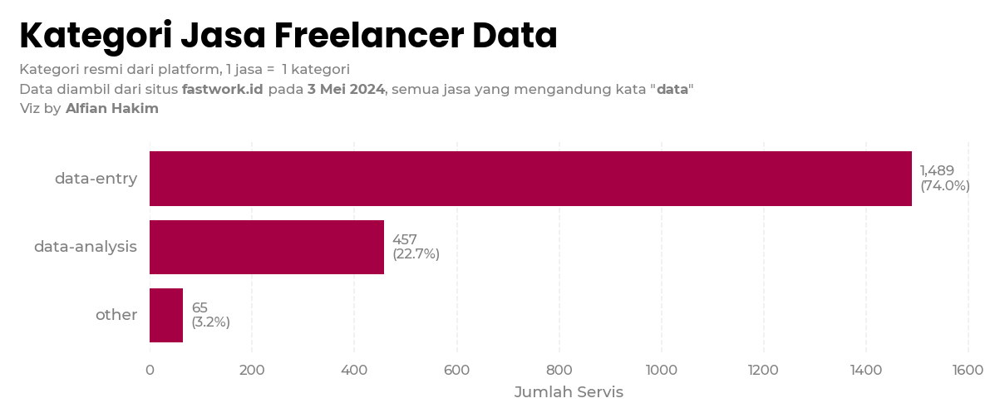

In [17]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars = ax1.barh(df_agg_category['general_category'], df_agg_category['count'], color=b_colors[0])

_, xmax = ax1.get_xlim()

for bar in bars:
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{width:,}\n({width / df_agg_category['count'].sum() * 100:.1f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c='grey', fontsize=8)



ax1.set_yticklabels(df_agg_category['general_category'], rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


x_min = 0
x_max = df_agg_category['count'].max()*1.1

ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Jumlah Servis', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Kategori Jasa Freelancer Data',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Kategori resmi dari platform, 1 jasa =  1 kategori\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


In [18]:
df_agg_category['count_unsold'] = df_agg_category['count']-df_agg_category['count_sold']

for status in ['sold', 'unsold']:
    df_agg_category[f'{status}_pct'] = df_agg_category[f'count_{status}']/df_agg_category['count']*100

df_agg_category = df_agg_category.sort_values('sold_pct').reset_index(drop=True)

df_agg_category

,general_category,count,count_sold,count_unsold,sold_pct,unsold_pct
0,data-entry,1489,108,1381,7.253190,92.746810
1,other,65,16,49,24.615385,75.384615
2,data-analysis,457,146,311,31.947484,68.052516


#### Viz Persentase Terjual per Kategori Resmi

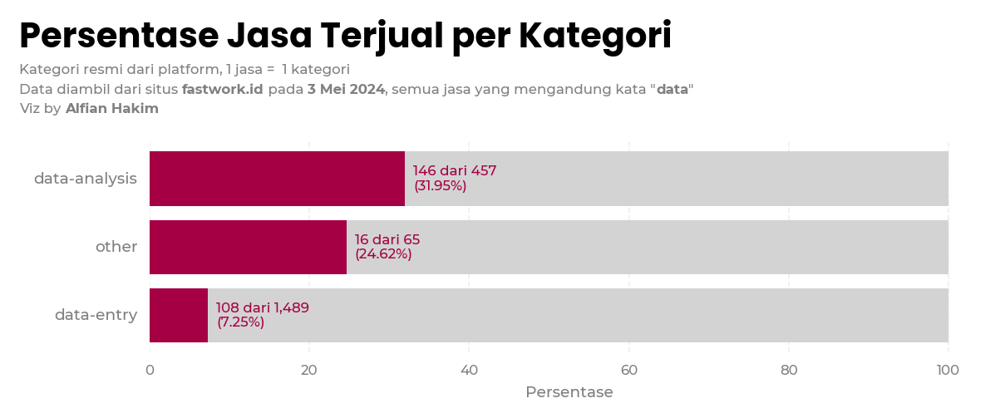

In [19]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars_1 = ax1.barh(df_agg_category['general_category'],
                  df_agg_category['sold_pct'], color=b_colors[0])
bars_2 = ax1.barh(df_agg_category['general_category'], df_agg_category['unsold_pct'],
                  left=df_agg_category['sold_pct'], color='lightgray')

_, xmax = ax1.get_xlim()

for i, bar in enumerate(bars_1):
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{df_agg_category.iloc[i]['count_sold']:,} dari {df_agg_category.iloc[i]['count']:,}\n({width:.2f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c=b_colors[0], fontsize=8)



ax1.set_yticklabels(df_agg_category['general_category'], rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


# x_min = 0
# x_max = df_agg_category['count'].max()*1.1

# ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Persentase', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Persentase Jasa Terjual per Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Kategori resmi dari platform, 1 jasa =  1 kategori\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


- banyak kategori yg masuk, tapi didominasi oleh entri data
- entri data kurang menjanjikan dengan rate terjual yang rendah
- kita hanya akan fokus pada kategori analisis data utk selanjutnya
- apakah ada yg salah kategori atau dia menawarkan pekerjaan yg masuk 2 kategori (misal: entri data sekaligus analisis data)?

In [20]:
df_services.loc[(df_services['category']!='data-analysis') & (df_services['description'].apply(lambda x:'analisis' in x.lower()))].shape[0]

98

- kita temukan 98 servis dengan kategori selain analisis data yg juga mengandung kata 'analisis', hal ini menunjukkan bahwa sebenarnya 1 servis bisa masuk lebih dari 1 kategori
- seperti contoh di bawah ini

In [21]:
print(df_services.loc[(df_services['category']!='data-analysis') & (df_services['description'].apply(lambda x:'analisis' in x.lower()))].iloc[-1]['description'])

Saya siap mengerjakan tugas sebagai Data Entry, Data Mining, Data Visualisasi, Data Cleaning, dan Tugas Admin/Clerikal.
Siap mengerjakan dan stanby 24/7, KERAHASIAAN DATA TERJAGA (Data Confidentiality)

- Data Entry : 
a. JPG/PDF/GForm/Website/Database ke Microsoft Excel, Google Spreadsheet 

- Data Cleaning 
a. Menjadikan Tabel 
b. Menghilangkan Duplicates / data double 
c. Sorting 
d. Menghilangkan rumus / sebaliknya 

- Data Analisis & Visualisasi 
a. Merubah data kedalam Pivotable 
b. Menampilkan Chart/Grafik/dsb secara otomatis sesuai data yang ingin di tampilkan
c. Menjadikan sebuah Dashboard 

- Data Mining & Internet Research 
a. Mencari serta mengumpulkan data melalui online ke Microsoft Excel, Google Spreadsheet 
b. Membersihkan data yang tidak relevan 

- Admin Task 
a. Data Entry 
b. Data Cleaning 
c. Data Analisis & Visualisasi 
d. Data Mining & Research
3. Convert data memakai rumus 
f. Convert dokumen
g. dll


- untuk menyaring yg berkategori data analytics/data science, kita seragamkan bahasa dari judul+deskripsi ke bahasa inggris
- lalu dilakukan flagging berdasarkan kata kunci

### Kategori Berdasarkan Keyword

In [22]:
df_services['description_translated'] = df_services.apply(lambda row: trans_to_en(row['description']), axis=1)
df_services['title_translated'] = df_services.apply(lambda row: trans_to_en(row['title']), axis=1)

df_services['title_desc_translated'] = df_services['title_translated']+'\n\n'+df_services['description_translated']

In [23]:
print(df_services.loc[(df_services['category']!='data-analysis') & (df_services['description'].apply(lambda x:'analisis' in x.lower()))].iloc[-1]['title_desc_translated'])

Data Entry Services, Data Mining, Data Visualization, Data Cleaning, and Admin/Clerical Duties.

I am ready to carry out tasks as Data Entry, Data Mining, Data Visualization, Data Cleaning, and Admin/Clerical Tasks.
Ready to work and on standby 24/7, DATA CONFIDENTIALITY MAINTAINED (Data Confidentiality)

- Data Entry: 
a. JPG/PDF/GForm/Website/Database to Microsoft Excel, Google Spreadsheet 

- Data Cleaning 
a. Making a Table 
b. Eliminate Duplicates / double data 
c. Sorting 
d. Omits the formula / vice versa 

- Data Analysis & Visualization 
a. Convert data into Pivotable 
b. Displays charts/graphs/etc. automatically according to the data you want to display
c. Make it a Dashboard 

- Data Mining & Internet Research 
a. Search and collect data online in Microsoft Excel, Google Spreadsheet 
b. Cleaning irrelevant data 

- Admin Tasks 
a. Data Entry 
b. Data Cleaning 
c. Data Analysis & Visualization 
d. Data Mining & Research
3. Convert data using a formula 
f. Convert documents
g.

- sebelum kita definisikan kata-kata kunci untuk flagging, mari kita coba lihat kata apa saja yang sering muncul

#### Identifikasi Keyword

In [24]:
import nltk
import spacy
from collections import Counter
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

In [25]:
# Load the Spacy model
nlp = spacy.load("en_core_web_sm")

# Download NLTK data
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [26]:
def preprocess_text(text):
    stop_words = set(stopwords.words('english'))
    lemmatizer = WordNetLemmatizer()
    words = nltk.word_tokenize(text.lower())
    words = [lemmatizer.lemmatize(word) for word in words if word.isalpha() and word not in stop_words]
    return words

def get_most_common_terms(df, column):
    all_terms = []
    for text in df[column]:
        terms = preprocess_text(text)
        all_terms.extend(terms)
    return Counter(all_terms).most_common()


In [27]:
# Get the most common terms
common_terms = get_most_common_terms(df_services, 'title_desc_translated')
print("Most common terms:", common_terms[:10])

# Non-analytics
common_terms_na = get_most_common_terms(df_services.loc[df_services['category']!='data-analysis'], 'title_desc_translated')
print("Most common terms (non-analytics):", common_terms_na[:10])

# Analytics
common_terms_a = get_most_common_terms(df_services.loc[df_services['category']=='data-analysis'], 'title_desc_translated')
print("Most common terms (analytics):", common_terms_a[:10])

Most common terms: [('data', 8894), ('entry', 3012), ('excel', 2175), ('service', 1799), ('work', 1751), ('processing', 1048), ('analysis', 950), ('experience', 674), ('word', 639), ('using', 597)]
Most common terms (non-analytics): [('data', 6888), ('entry', 2937), ('excel', 1869), ('work', 1596), ('service', 1430), ('word', 621), ('processing', 542), ('experience', 540), ('microsoft', 524), ('input', 506)]
Most common terms (analytics): [('data', 2006), ('analysis', 745), ('processing', 506), ('test', 474), ('service', 369), ('spss', 330), ('excel', 306), ('using', 304), ('visualization', 206), ('thesis', 170)]


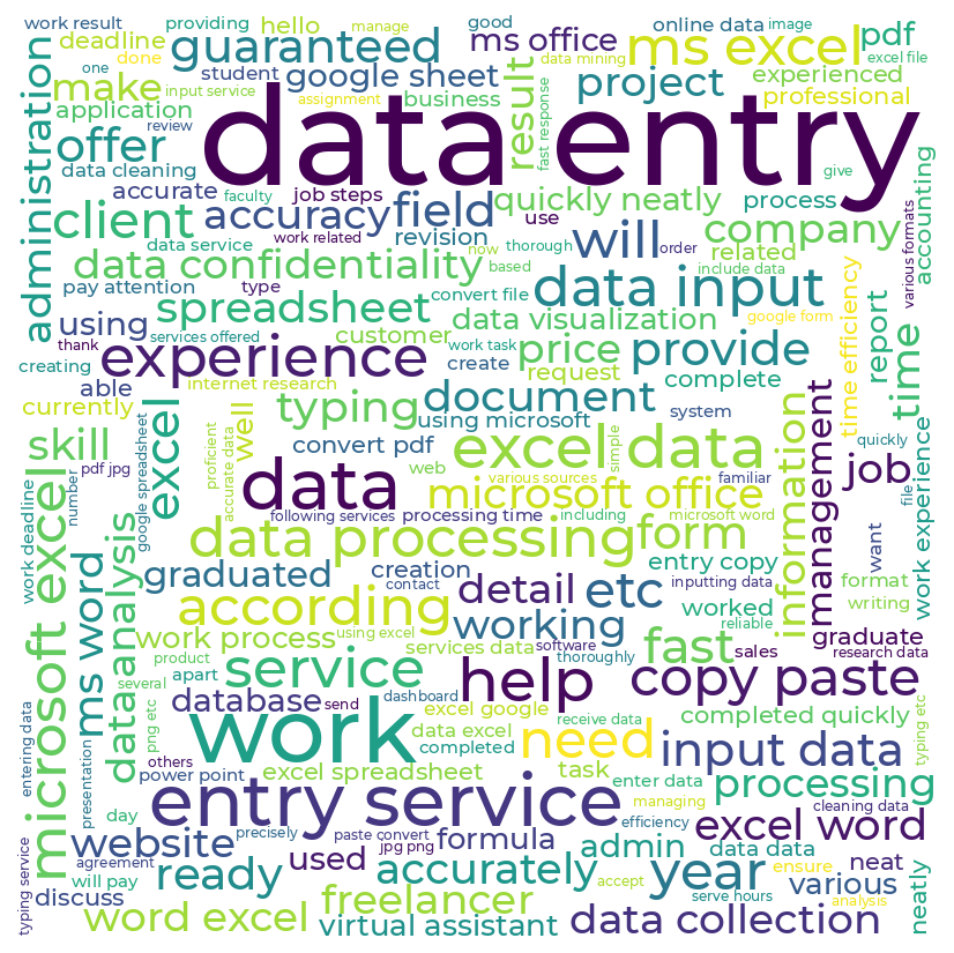

In [28]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_services.loc[df_services['category']!='data-analysis','title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

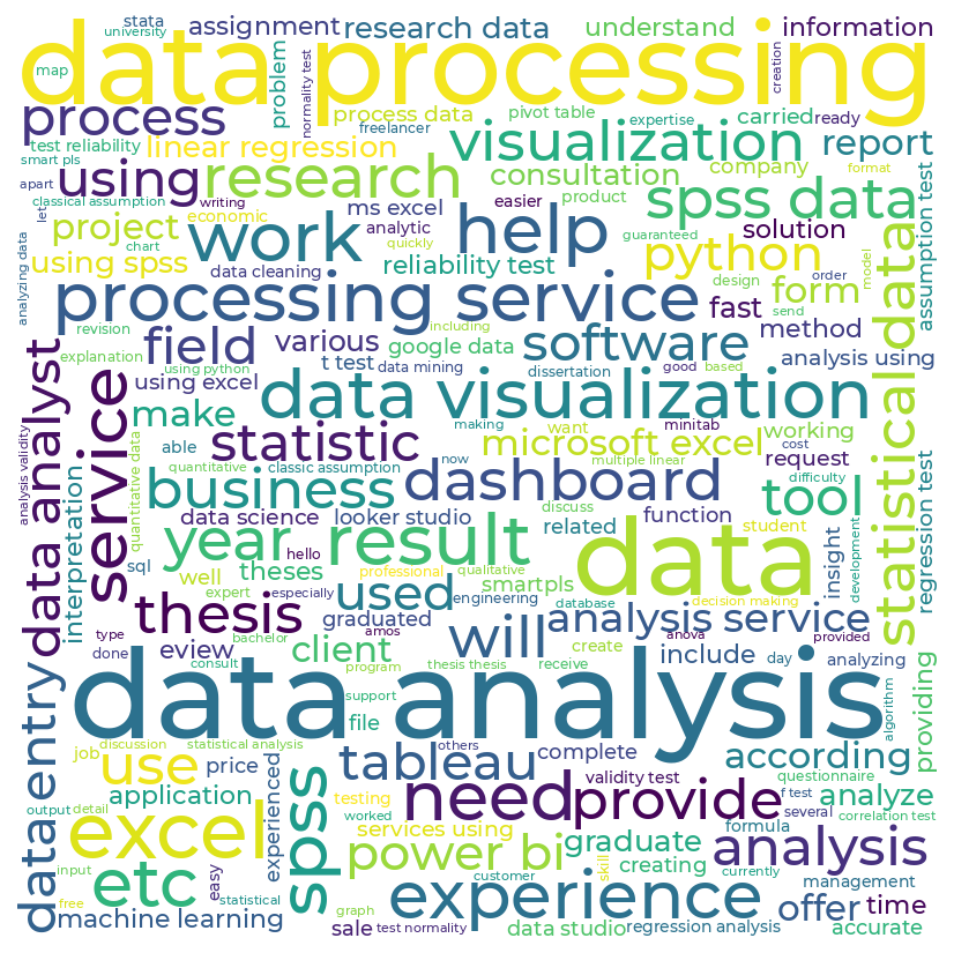

In [29]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_services.loc[df_services['category']=='data-analysis','title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

##### Viz Word Cloud

In [30]:
x, y = np.ogrid[:800, :800]
mask = (x - 400) ** 2 + (y - 400) ** 2 > 480 ** 2
mask = 255 * mask.astype(int)

text_left = " ".join(df_services.loc[df_services['category']!='data-analysis','title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc_left = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: "gray"
  # color_func=get_single_color_func("black")
  )
wc_left.generate(text_left)

text_right = " ".join(df_services.loc[df_services['category']=='data-analysis','title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc_right = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func(b_colors[0])
  )
wc_right.generate(text_right)

(0.0, 8.0, 0.0, 4.5)

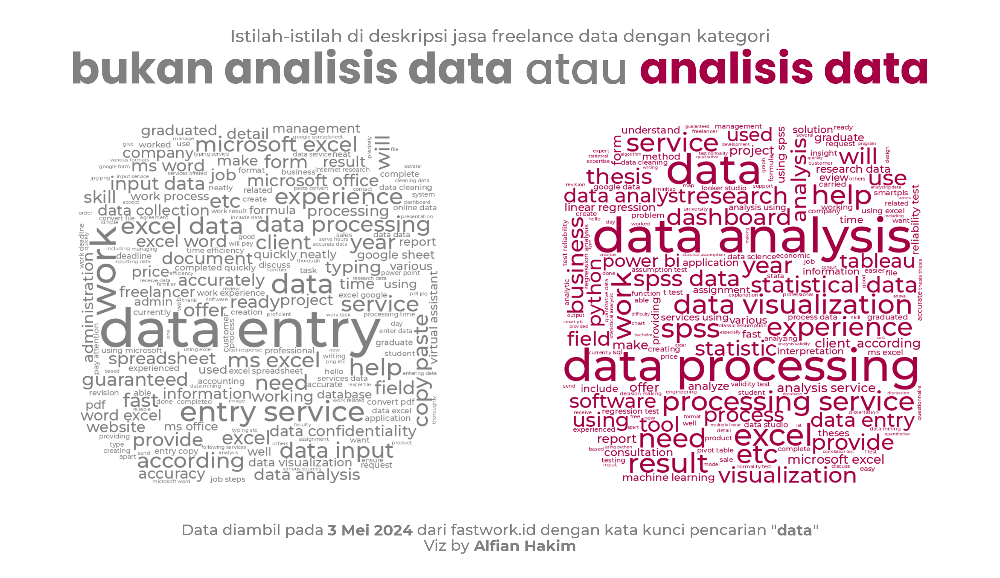

In [31]:
fig, ax = plt.subplots(figsize=(8,4.5), dpi=400)

ax.set_xlim(0, 8)
ax.set_ylim(0, 4.5)

# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([0.5, 0.5])
ax_point_2 = DC_to_NFC([3.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([0.5, 0.6])

left_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

left_ax.axis("off")
left_ax.imshow(wc_left, interpolation = "bilinear")




# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([4.5, 0.5])
ax_point_2 = DC_to_NFC([7.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([4.5, 0.6])

right_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

right_ax.axis("off")
right_ax.imshow(wc_right, interpolation = "bilinear")

ax.annotate(
    xy=(4, 4.25),
    text="Istilah-istilah di deskripsi jasa freelance data dengan kategori",
    ha='center',
    va='bottom',
    color='gray',
    fontsize = 8,
    # font="Poppins",
    weight="medium"
)

ax_text(x=4, y= 4.2,
                       s = '<bukan analisis data> atau <analisis data>',
                       highlight_textprops = [
                           {"color":'gray', "weight":"bold", "font":"Poppins"},
                           {"color":b_colors[0], "weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = 'gray',
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=4, y= 0.15,
                       s = 'Data diambil pada <3 Mei 2024> dari fastwork.id dengan kata kunci pencarian "<data>"',
                       highlight_textprops = [
                           {"weight":"bold"},
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='bottom', weight="medium",
                       ax=ax)

ax_text(x=4, y= 0.14,
                       s = 'Viz by <Alfian Hakim>',
                       highlight_textprops = [
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='top', weight="medium",
                       ax=ax)

ax.axis("off")

- melalui analisis kata kunci di atas, kita dapat rumuskan kira-kira apa saja kata kunci analisis data
- setelah daftar kata kunci terdefinisikan, kita dapat buat rule jika kata tersebut ada maka termasuk kategori data analytics

#### Kategori Baru Berdasarkan Keyword

In [32]:
analytics_keywords = [
    'data analysis',
    'data analyst',
    'data science',
    'data scientist',
    'statistics',
    'statistical data',
    'statistical analysis',
    'machine learning',
    'deep learning',
    'regression',
    'data visualization',
    'dashboard'
]

In [33]:
df_services['is_analytics'] = 'Data Entry, Lainnya'
for keyword in analytics_keywords:
    # jika kategori sudah data analisis
    df_services.loc[df_services['category']=='data-analysis', 'is_analytics'] = 'Data Analytics'

    # jika mengandung kata kunci
    df_services.loc[df_services['title_desc_translated'].str.lower().str.contains(keyword), 'is_analytics'] = 'Data Analytics'

In [34]:
df_agg_category = df_services.groupby(['is_analytics'], as_index=False).agg({'url':'nunique'}).rename({'url':'count'}, axis=1).sort_values('count').reset_index(drop=True)
df_agg_category_sold = df_services.loc[df_services['purchase_count']>0].groupby(['is_analytics'], as_index=False).agg({'url':'nunique'}).rename({'url':'count_sold'}, axis=1).sort_values('count_sold').reset_index(drop=True)
df_agg_category = pd.merge(df_agg_category, df_agg_category_sold)
df_agg_category

,is_analytics,count,count_sold
0,Data Analytics,671,181
1,"Data Entry, Lainnya",1340,89


- jumlah kategori analisis data meningkat dari yang sebelumnya 457 menjadi 671

##### Viz Kategori Baru

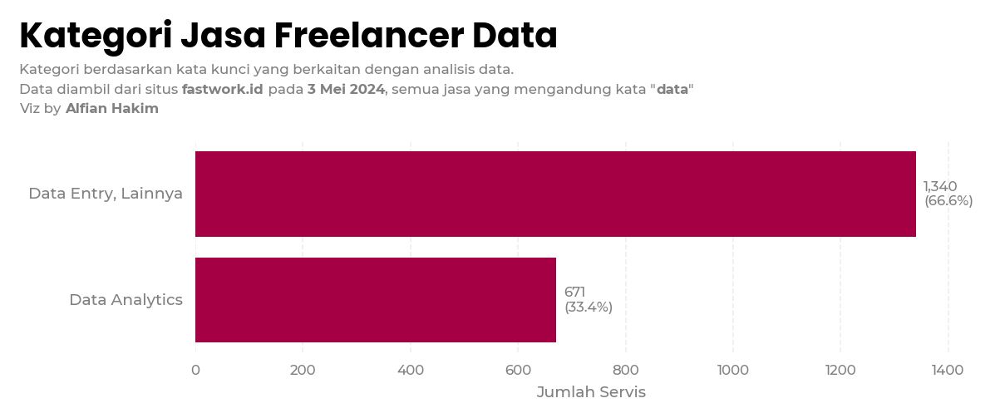

In [35]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars = ax1.barh(df_agg_category['is_analytics'], df_agg_category['count'], color=b_colors[0])

_, xmax = ax1.get_xlim()

for bar in bars:
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{width:,}\n({width / df_agg_category['count'].sum() * 100:.1f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c='grey', fontsize=8)



ax1.set_yticklabels(df_agg_category['is_analytics'], rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


x_min = 0
x_max = df_agg_category['count'].max()*1.1

ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Jumlah Servis', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Kategori Jasa Freelancer Data',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


In [36]:
df_agg_category['count_unsold'] = df_agg_category['count']-df_agg_category['count_sold']

for status in ['sold', 'unsold']:
    df_agg_category[f'{status}_pct'] = df_agg_category[f'count_{status}']/df_agg_category['count']*100

df_agg_category = df_agg_category.sort_values('sold_pct').reset_index(drop=True)

df_agg_category

,is_analytics,count,count_sold,count_unsold,sold_pct,unsold_pct
0,"Data Entry, Lainnya",1340,89,1251,6.641791,93.358209
1,Data Analytics,671,181,490,26.974665,73.025335


##### Viz Persentase Terjual per Kategori Resmi

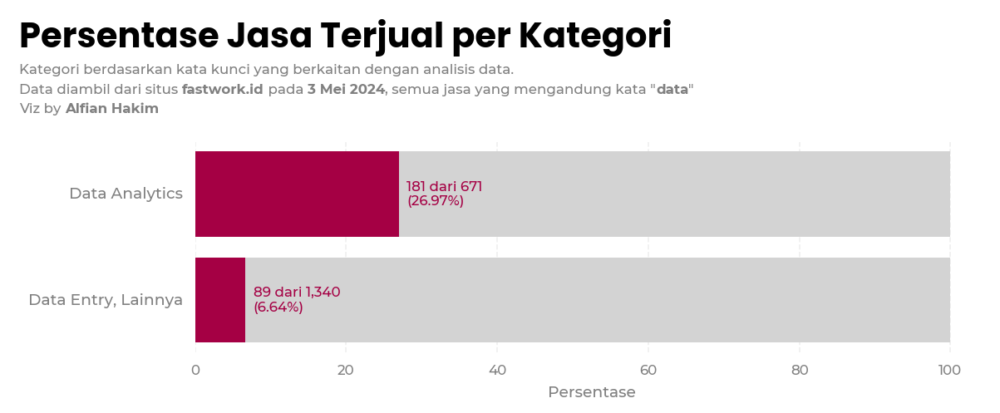

In [37]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars_1 = ax1.barh(df_agg_category['is_analytics'],
                  df_agg_category['sold_pct'], color=b_colors[0])
bars_2 = ax1.barh(df_agg_category['is_analytics'], df_agg_category['unsold_pct'],
                  left=df_agg_category['sold_pct'], color='lightgray')

_, xmax = ax1.get_xlim()

for i, bar in enumerate(bars_1):
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{df_agg_category.iloc[i]['count_sold']:,} dari {df_agg_category.iloc[i]['count']:,}\n({width:.2f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c=b_colors[0], fontsize=8)



ax1.set_yticklabels(df_agg_category['is_analytics'], rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


# x_min = 0
# x_max = df_agg_category['count'].max()*1.1

# ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Persentase', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Persentase Jasa Terjual per Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


#### Subkategori Data Analytics
- kita sudah tentukan kata-kata kunci untuk mendapatkan jasa data analytics
- kita akan coba perdalam, jasa data analytics apa yg ditawarkan dengan 2 subkategori jasa data yaitu pekerjaan data science (machine learning, dll) dan data analysis (visualisasi, dll)

In [38]:
df_analytics = df_services.loc[df_services['is_analytics']=='Data Analytics'].drop('is_analytics',axis=1).reset_index(drop=True)

In [39]:
analytics_keywords

['data analysis',
 'data analyst',
 'data science',
 'data scientist',
 'statistics',
 'statistical data',
 'statistical analysis',
 'machine learning',
 'deep learning',
 'regression',
 'data visualization',
 'dashboard']

In [40]:
keywords = {
    'data science':[
        'data science',
        'data scientist',
        'machine learning',
        'deep learning',
        'classification',
        'clustering',
        'regression',
        'natural language processing',
        'nlp'
    ],
    'data analysis':[
        'data analysis',
        'data analyst',
        'data visualization',
        'dashboard'
    ]
}

In [41]:
subkat_cols = []
for subkat, l_keyword in keywords.items():
    subkat_col = 'is_{}'.format(subkat.replace(' ','_'))
    subkat_cols.append(subkat_col)
    df_analytics[subkat_col] = 0
    for keyword in l_keyword:
        df_analytics.loc[df_analytics['title_desc_translated'].str.lower().str.contains(keyword), 'is_{}'.format(subkat.replace(' ','_'))] = 1

In [42]:
df_analytics['is_both'] = 0
df_analytics.loc[(df_analytics['is_data_analysis']==1) & (df_analytics['is_data_science']==1),'is_both'] = 1

df_analytics['is_other'] = 0
df_analytics.loc[(df_analytics['is_data_analysis']==0) & (df_analytics['is_data_science']==0),'is_other'] = 1

In [43]:
df_analytics[subkat_cols+['is_both','is_other']].sum()

is_data_science     134
is_data_analysis    507
is_both              95
is_other            125
dtype: int64

- banyak juga othernya, mari kita lihat other ini tuh jasanya seperti apa

##### Viz Word Cloud Subkategori Data Analytics

In [44]:
x, y = np.ogrid[:800, :800]
mask = (x - 400) ** 2 + (y - 400) ** 2 > 480 ** 2
mask = 255 * mask.astype(int)

text_left = " ".join(df_analytics.loc[df_analytics['is_data_science']==1,'title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc_left = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[4]
  # color_func=get_single_color_func("black")
  )
wc_left.generate(text_left)

text_center = " ".join(df_analytics.loc[df_analytics['is_data_analysis']==1,'title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc_center = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[2]
  # color_func=get_single_color_func("black")
  )
wc_center.generate(text_center)

text_right = " ".join(df_analytics.loc[df_analytics['is_other']==1,'title_desc_translated'].apply(lambda x:x.lower()).tolist())

wc_right = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: "gray"
  # color_func=get_single_color_func(b_colors[0])
  )
wc_right.generate(text_right)

(0.0, 12.0, 0.0, 4.5)

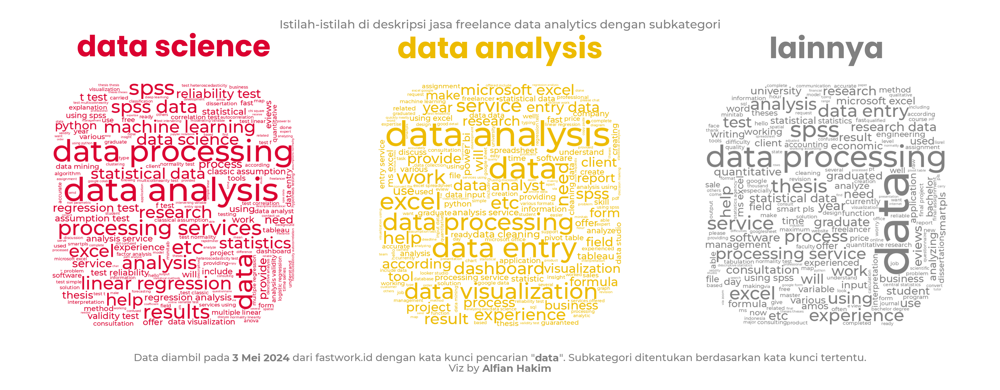

In [45]:
fig, ax = plt.subplots(figsize=(12,4.5), dpi=400)

ax.set_xlim(0, 12)
ax.set_ylim(0, 4.5)

# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([0.5, 0.5])
ax_point_2 = DC_to_NFC([3.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([0.5, 0.6])

left_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

left_ax.axis("off")
left_ax.imshow(wc_left, interpolation = "bilinear")




# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([4.5, 0.5])
ax_point_2 = DC_to_NFC([7.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([4.5, 0.6])

center_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

center_ax.axis("off")
center_ax.imshow(wc_center, interpolation = "bilinear")


# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([8.5, 0.5])
ax_point_2 = DC_to_NFC([11.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([8.5, 0.6])

right_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

right_ax.axis("off")
right_ax.imshow(wc_right, interpolation = "bilinear")

ax.annotate(
    xy=(6, 4.25),
    text="Istilah-istilah di deskripsi jasa freelance data analytics dengan subkategori",
    ha='center',
    va='bottom',
    color='gray',
    fontsize = 8,
    # font="Poppins",
    weight="medium"
)

ax_text(x=2, y= 4.2,
                       s = '<data science>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[4],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 4.2,
                       s = '<data analysis>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[2],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=10, y= 4.2,
                       s = '<lainnya>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = 'gray',
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 0.15,
                       s = 'Data diambil pada <3 Mei 2024> dari fastwork.id dengan kata kunci pencarian "<data>". Subkategori ditentukan berdasarkan kata kunci tertentu.',
                       highlight_textprops = [
                           {"weight":"bold"},
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='bottom', weight="medium",
                       ax=ax)

ax_text(x=6, y= 0.14,
                       s = 'Viz by <Alfian Hakim>',
                       highlight_textprops = [
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='top', weight="medium",
                       ax=ax)

ax.axis("off")

- data processing, spss muncul di ketiganya
- lainnya cenderung muncul tentang thesis (skripsi), disertasi, smart pls mengindikasikan jasa olah data penelitian

##### Viz Subkategori Data Analytics

In [46]:
df_agg_subkat = pd.DataFrame(df_analytics[subkat_cols+['is_other','is_both']].sum().T).reset_index().rename({'index':'subcat',0:'count'},axis=1).sort_values('count').reset_index(drop=True)
df_agg_subkat_sold = pd.DataFrame(df_analytics.loc[df_analytics['purchase_count']>0][subkat_cols+['is_other','is_both']].sum().T).reset_index().rename({'index':'subcat',0:'count_sold'},axis=1).sort_values('count_sold').reset_index(drop=True)

df_agg_subkat = pd.merge(df_agg_subkat, df_agg_subkat_sold)
df_agg_subkat

,subcat,count,count_sold
0,is_both,95,45
1,is_other,125,20
2,is_data_science,134,62
3,is_data_analysis,507,144


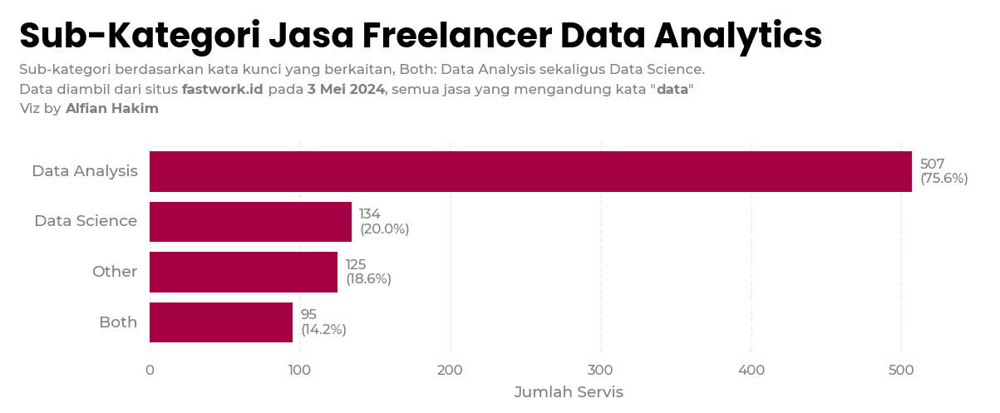

In [47]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars = ax1.barh(df_agg_subkat['subcat'], df_agg_subkat['count'], color=b_colors[0])

_, xmax = ax1.get_xlim()

for bar in bars:
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{width:,}\n({width / df_analytics.shape[0] * 100:.1f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c='grey', fontsize=8)



ax1.set_yticklabels(df_agg_subkat['subcat'].apply(lambda x:x.replace('is_','').replace('_',' ').title()), rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


x_min = 0
x_max = df_agg_subkat['count'].max()*1.1

ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Jumlah Servis', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Sub-Kategori Jasa Freelancer Data Analytics',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


##### Viz Persentase Terjual Subkategori Data Analytics

In [48]:
df_agg_subkat['count_unsold'] = df_agg_subkat['count']-df_agg_subkat['count_sold']

for status in ['sold', 'unsold']:
    df_agg_subkat[f'{status}_pct'] = df_agg_subkat[f'count_{status}']/df_agg_subkat['count']*100

df_agg_subkat = df_agg_subkat.sort_values('sold_pct').reset_index(drop=True)

df_agg_subkat

,subcat,count,count_sold,count_unsold,sold_pct,unsold_pct
0,is_other,125,20,105,16.000000,84.000000
1,is_data_analysis,507,144,363,28.402367,71.597633
2,is_data_science,134,62,72,46.268657,53.731343
3,is_both,95,45,50,47.368421,52.631579


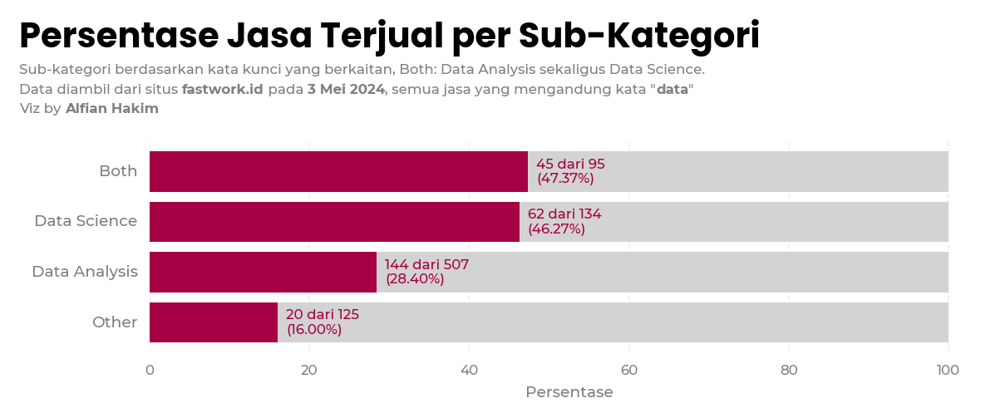

In [49]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars_1 = ax1.barh(df_agg_subkat['subcat'],
                  df_agg_subkat['sold_pct'], color=b_colors[0])
bars_2 = ax1.barh(df_agg_subkat['subcat'], df_agg_subkat['unsold_pct'],
                  left=df_agg_subkat['sold_pct'], color='lightgray')

_, xmax = ax1.get_xlim()

for i, bar in enumerate(bars_1):
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{df_agg_subkat.iloc[i]['count_sold']:,} dari {df_agg_subkat.iloc[i]['count']:,}\n({width:.2f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c=b_colors[0], fontsize=8)



ax1.set_yticklabels(df_agg_subkat['subcat'].apply(lambda x:x.replace('is_','').replace('_',' ').title()), rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


# x_min = 0
# x_max = df_agg_category['count'].max()*1.1

# ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Persentase', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Persentase Jasa Terjual per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


## Analisis #2 Harga Jasa

### Starting Price

In [50]:
df_services.head()

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time,general_category,description_translated,title_translated,title_desc_translated,is_analytics
0,https://fastwork.id/user/databridge/data-analysis-81645518,databridge,data-analysis,https://storage.googleapis.com/fastwork-static/5051ab30-6d92-4367-b598-20e1a7e260a6.jpg,"Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer",80000,1,5.0,1,23.0,0,0,0,0,"Jika Anda mencari bantuan dalam bidang pembelajaran mesin, visi komputer, pemrosesan bahasa alami, pembelajaran mendalam, atau aspek kecerdasan buatan lainnya, yakinlah, kami memiliki keahlian dan kemahiran yang diperlukan untuk mendorong Anda menuju kesuksesan.\n\nSebelum melakukan pemesanan, silakan hubungi kami dengan rincian proyek Anda.\n\nBerikut adalah layanan Machine Learning yang kami tawarkan:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting / Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised / Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nLayanan kami dirancang agar cepat, dapat diandalkan, dan hemat biaya, dengan memprioritaskan pemberian hasil terbaik yang disesuaikan dengan kebutuhan Anda.",1,3,500000,3.0,7.0,data-analysis,"If you're looking for help in the areas of machine learning, computer vision, natural language processing, deep learning, or any other aspect of artificial intelligence, rest assured, we have the expertise and proficiency needed to propel you to success.\n\nBefore placing an order, please contact us with the details of your project.\n\nFollowing are the Machine Learning services we offer:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting/Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised/Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nOur services are designed to be fast, reliable and cost-effective, prioritizing delivering the best results tailored to your needs.","Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer","Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer\n\nIf you're looking for help in the areas of machine learning, computer vision, natural language processing, deep learning, or any other aspect of artificial intelligence, rest assured, we have the expertise and proficiency needed to propel you to success.\n\nBefore placing an order, please contact us with the details of your project.\n\nFollowing are the Machine Learning services we offer:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting/Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised/Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV

In [51]:
df_services['is_sold'] = 0
df_services.loc[df_services['purchase_count']>0,'is_sold'] = 1

- apakah ada outlier?

In [52]:
print("""Starting price descriptive statistics:
- Mean: Rp{:,}
- Std. Deviation: Rp{:,}
- Min: Rp{:,}
- P25: Rp{:,}
- P50: Rp{:,}
- P75: Rp{:,}
- Max: Rp{:,}""".format(df_services['starting_price'].mean(),
                          df_services['starting_price'].std(),
                          df_services['starting_price'].min(),
                          df_services['starting_price'].quantile(0.25),
                          df_services['starting_price'].median(),
                          df_services['starting_price'].quantile(0.75),
                          df_services['starting_price'].max()))

Starting price descriptive statistics:
- Mean: Rp99,726.15315763302
- Std. Deviation: Rp210,320.22879352476
- Min: Rp19,000
- P25: Rp50,000.0
- P50: Rp50,000.0
- P75: Rp70,000.0
- Max: Rp3,750,000


In [53]:
df_z = df_services.copy()
std = df_z['starting_price'].std()
mean = df_z['starting_price'].mean()
df_z['starting_price_z'] = (df_z['starting_price']-mean)/std

In [54]:
df_z.loc[(df_z['starting_price_z']>=3) | (df_z['starting_price_z']<=-3)]

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time,general_category,description_translated,title_translated,title_desc_translated,is_analytics,is_sold,starting_price_z
60,https://fastwork.id/user/rokssitd/web-programming-other-91477985,rokssitd,web-programming-other,https://storage.googleapis.com/fastwork-static/97f326fe-e593-4589-84e8-d84b4d13f513.jpg,"Data Science, Machine Learning, Deep Learning Consultant",1000000,0,NaN,0,38.0,0,0,0,0,"Selamat Datang di Layanan AI yang Menginspirasi!\n\nHalo, penjelajah potensi tak terbatas! Temukanlah dunia yang luas dengan kecerdasan buatan (AI)! Saya siap membantu mewujudkan impian Anda.\n\nLayanan yang Saya Tawarkan:\n\nAnalisis Data Mengagumkan\nPengenalan Objek untuk Menghidupkan Ide Anda\nPrediksi Akurat untuk Membimbing Langkah Anda\nVisualisasi Data Memukau\nOtomatisasi Bisnis dengan Teknologi AI\nAlat & Teknologi:\n\nPython\nJupyter Notebook\nTensorFlow dan Keras\nOpenCV\nMengapa Memilih Saya:\n\nPengetahuan Mendalam\nKreativitas Tanpa Batas\nDukungan Terpercaya\nMari jelajahi potensi luar biasa AI bersama! Hubungi saya sekarang untuk konsultasi gratis.",0,1,1000000,7.0,7.0,other,"Welcome to Inspiring AI Services!\n\nHello, explorers of unlimited potential! Discover the vast world of artificial intelligence (AI)! I am ready to help make your dreams come true.\n\nServices I Offer:\n\nAwesome Data Analysis\nObject Recognition to Bring Your Ideas to Life\nAccurate Predictions to Guide Your Steps\nStunning Data Visualization\nBusiness Automation with AI Technology\nTools & Technology:\n\nPython\nJupyter Notebooks\nTensorFlow and Keras\nOpenCV\nWhy Choose Me:\n\nDeep Knowledge\nCreativity without limit\nTrusted Support\nLet's explore the incredible potential of AI together! Contact me now for a free consultation.","Data Science, Machine Learning, Deep Learning Consultant","Data Science, Machine Learning, Deep Learning Consultant\n\nWelcome to Inspiring AI Services!\n\nHello, explorers of unlimited potential! Discover the vast world of artificial intelligence (AI)! I am ready to help make your dreams come true.\n\nServices I Offer:\n\nAwesome Data Analysis\nObject Recognition to Bring Your Ideas to Life\nAccurate Predictions to Guide Your Steps\nStunning Data Visualization\nBusiness Automation with AI Technology\nTools & Technology:\n\nPython\nJupyter Notebooks\nTensorFlow and Keras\nOpenCV\nWhy Choose Me:\n\nDeep Knowledge\nCreativity without limit\nTrusted Support\nLet's explore the incredible potential of AI together! Contact me now for a free consultation.",Data Analytics,0,4.280491
96,https://fastwork.id/user/hokakuj2j/data-analysis-68033125,hokakuj2j,data-analysis,https://storage.googleapis.com/fastwork-static/5e0d1f34-08c9-4092-bcdf-f0b1669a98a2.jpg,Data Analyst,1000000,0,NaN,0,120.0,0,0,0,0,"Membuat laporan yang dibutuhkan berdasarkan data-data yang dikumpulkan dari hasil kegiatan operasional yang sudah dilakukan guna mendapatkan data yang akurat yang dapat digunakan untuk pengambilan keputusan baik perorangan maupun perusahaan.\n\nLaporan yang dihasilkan dapat disesuaikan dengan kebutuhan perorangan maupun manajemen perusahaan, dengan menyesuaikan data yang dibutuhkan dan hasil laporan yang diinginkan.\n\nSelain pengerjaan laporan dari data analisis, saya juga dapat membantu menarasikan hasil laporan yang sudah disusun agar lebih mudah dipahami dan dimengerti oleh manajemen dalam pengambilan keputusan yang tepat",0,3,2000000,7.0,14.0,data-analysis,"Create required reports based on data collected from the results of operational activities that have been carried out in order to obtain accurate data that can be used for decision making for both individuals and companies.\n\nThe resulting reports can be tailored to the needs of individuals and company management, by adjusting the required

In [55]:
df_z.loc[(df_z['starting_price_z']>=3) | (df_z['starting_price_z']<=-3)].shape[0]

22

- terdapat beberapa 22 outlier jika berdasarkan 3x std dev

#### Viz per Kategori

In [56]:
# Define a custom formatting function
def format_numbers(value, pos):
    if value >= 1000000:
        if (int(value/1000000) == value/1000000):
            return f"{int(value / 1000000)}jt"
        else:
            return f"{value / 1000000:.2f}jt"
    elif value >= 1000:
        if (int(value/1000) == value/1000):
            return f"{int(value / 1000)}rb"
        else:
            return f"{value / 1000:.2f}rb"
    else:
        return str(int(value))

##### 3 Std Dev

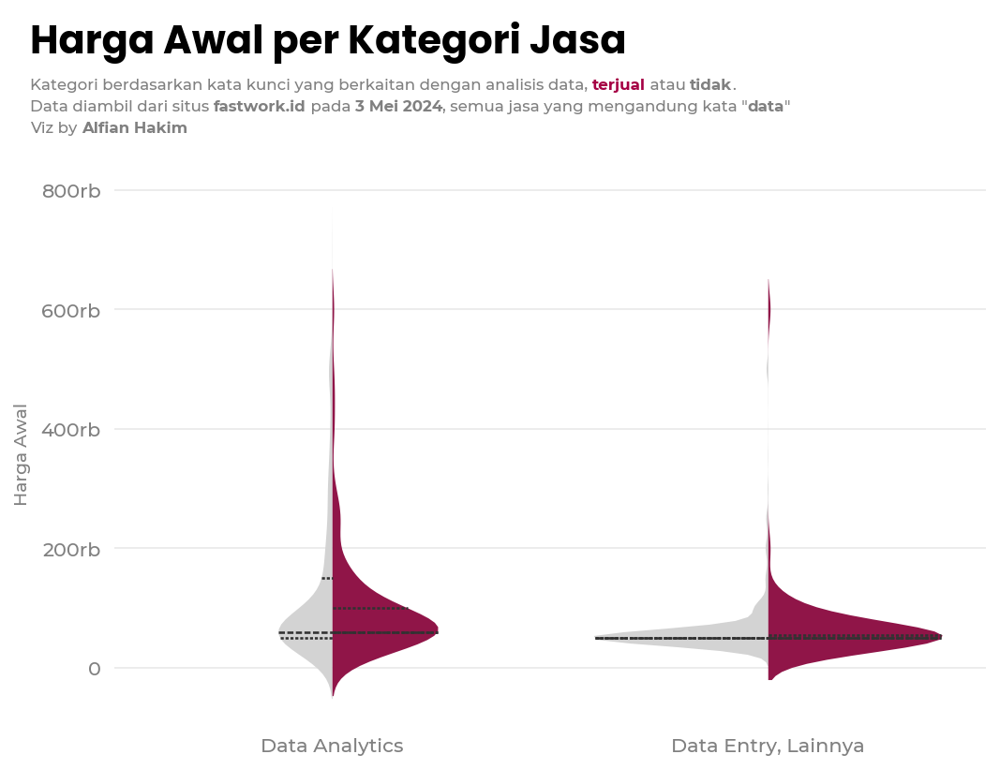

In [57]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_z.loc[(df_z['starting_price_z']<3) & (df_z['starting_price_z']>-3)],
               x="is_analytics", y="starting_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Awal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Awal per Kategori Jasa',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 2 Std Dev

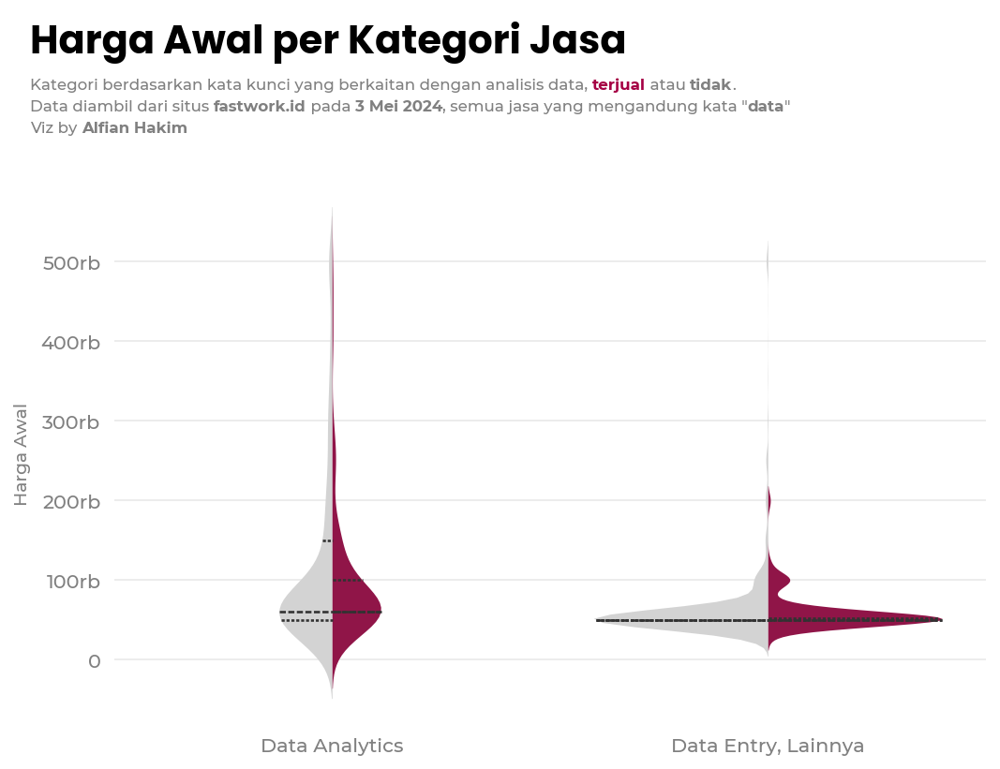

In [58]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_z.loc[(df_z['starting_price_z']<2) & (df_z['starting_price_z']>-2)],
               x="is_analytics", y="starting_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Awal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Awal per Kategori Jasa',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 1 Std Dev

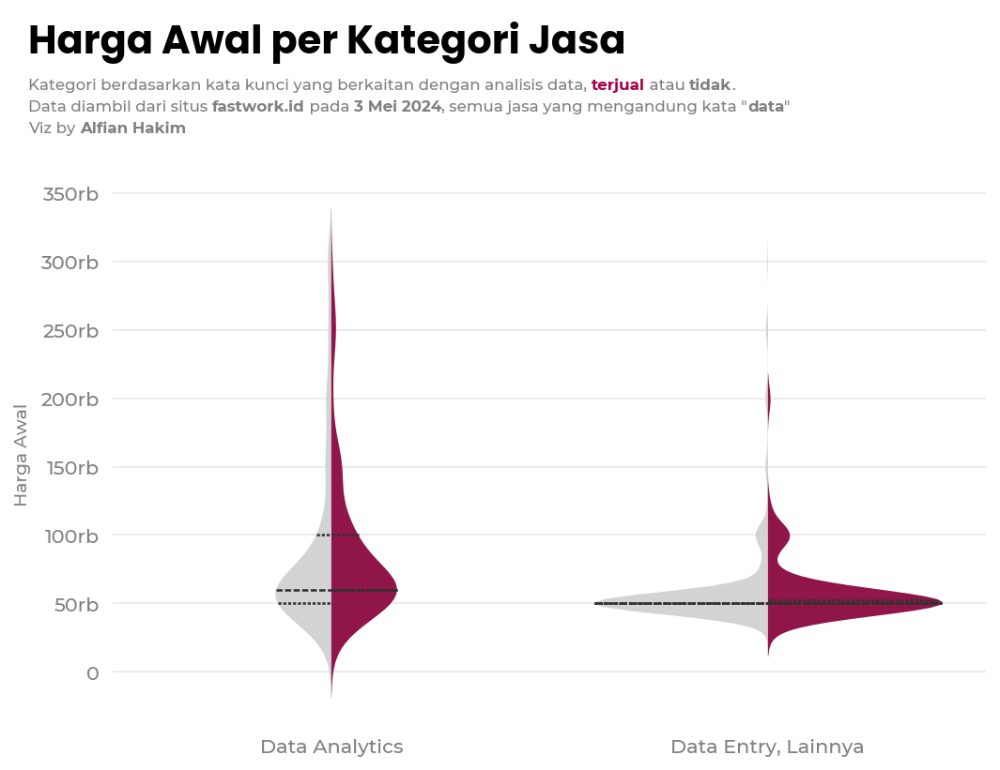

In [59]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_z.loc[(df_z['starting_price_z']<1) & (df_z['starting_price_z']>-1)],
               x="is_analytics", y="starting_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Awal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Awal per Kategori Jasa',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

- mayoritas harga awal di sekitar 50rb utk kategori data analytics maupun bukan
- kategori data analytics lebih mahal daripada kategori lain
- harga awal pada jasa yg terjual malah cenderung sedikit lebih tinggi daripada yg tidak terjual

#### Viz per Subkategori Data Analytcics

In [60]:
df_analytics.head()

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time,general_category,description_translated,title_translated,title_desc_translated,is_data_science,is_data_analysis,is_both,is_other
0,https://fastwork.id/user/databridge/data-analysis-81645518,databridge,data-analysis,https://storage.googleapis.com/fastwork-static/5051ab30-6d92-4367-b598-20e1a7e260a6.jpg,"Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer",80000,1,5.0,1,23.0,0,0,0,0,"Jika Anda mencari bantuan dalam bidang pembelajaran mesin, visi komputer, pemrosesan bahasa alami, pembelajaran mendalam, atau aspek kecerdasan buatan lainnya, yakinlah, kami memiliki keahlian dan kemahiran yang diperlukan untuk mendorong Anda menuju kesuksesan.\n\nSebelum melakukan pemesanan, silakan hubungi kami dengan rincian proyek Anda.\n\nBerikut adalah layanan Machine Learning yang kami tawarkan:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting / Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised / Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nLayanan kami dirancang agar cepat, dapat diandalkan, dan hemat biaya, dengan memprioritaskan pemberian hasil terbaik yang disesuaikan dengan kebutuhan Anda.",1,3,500000,3.0,7.0,data-analysis,"If you're looking for help in the areas of machine learning, computer vision, natural language processing, deep learning, or any other aspect of artificial intelligence, rest assured, we have the expertise and proficiency needed to propel you to success.\n\nBefore placing an order, please contact us with the details of your project.\n\nFollowing are the Machine Learning services we offer:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting/Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised/Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nOur services are designed to be fast, reliable and cost-effective, prioritizing delivering the best results tailored to your needs.","Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer","Data Analysis, Data Science, Machine Learning, and Deep Learning Engineer\n\nIf you're looking for help in the areas of machine learning, computer vision, natural language processing, deep learning, or any other aspect of artificial intelligence, rest assured, we have the expertise and proficiency needed to propel you to success.\n\nBefore placing an order, please contact us with the details of your project.\n\nFollowing are the Machine Learning services we offer:\n\n🔥🔥🔥 Data Science, Machine Learning, Deep Learning 🔥🔥🔥\nForecasting/Regression\nClassification / Clustering\nData Preprocessing\nData Visualization\nComputer Vision (Image Segmentation, Object Detection, Object Recognition, etc)\nNatural Language Processing (Text Classification, Sentiment Analysis, Semantic Analysis, BERT, etc)\nArtificial Intelligence\nSupervised/Unsupervised Learning\n\n🔥🔥🔥 Tools / Frameworks: 🔥🔥🔥\nPython\nMATLAB\nJupyter Notebook / Google Colab\nTableau\nLooker Studio\nSpyder\nTensorflow / Keras\nPyTorc

In [61]:
df_analytics['is_sold'] = 0
df_analytics.loc[df_analytics['purchase_count']>0,'is_sold'] = 1

- apakah ada outlier?

In [62]:
print("""Starting price descriptive statistics:
- Mean: Rp{:,}
- Std. Deviation: Rp{:,}
- Min: Rp{:,}
- P25: Rp{:,}
- P50: Rp{:,}
- P75: Rp{:,}
- Max: Rp{:,}""".format(df_analytics['starting_price'].mean(),
                          df_analytics['starting_price'].std(),
                          df_analytics['starting_price'].min(),
                          df_analytics['starting_price'].quantile(0.25),
                          df_analytics['starting_price'].median(),
                          df_analytics['starting_price'].quantile(0.75),
                          df_analytics['starting_price'].max()))

Starting price descriptive statistics:
- Mean: Rp159,019.81818181818
- Std. Deviation: Rp327,165.54801757704
- Min: Rp19,000
- P25: Rp50,000.0
- P50: Rp60,000.0
- P75: Rp150,000.0
- Max: Rp3,750,000


In [63]:
df_z = df_analytics.copy()
std = df_z['starting_price'].std()
mean = df_z['starting_price'].mean()
df_z['starting_price_z'] = (df_z['starting_price']-mean)/std

In [64]:
df_z.loc[(df_z['starting_price_z']>=3) | (df_z['starting_price_z']<=-3)]

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time,general_category,description_translated,title_translated,title_desc_translated,is_data_science,is_data_analysis,is_both,is_other,is_sold,starting_price_z
58,https://fastwork.id/user/bangbegs/infographics-73362423,bangbegs,infographics,https://storage.googleapis.com/fastwork-static/da743684-b579-4a5e-8b42-29f080bd0bc9.jpg,Data Bercerita! Desain infografis +bonus copywriting,1500000,0,NaN,0,NaN,0,0,0,0,"Saya membantu anda untuk bercerita dengan data, menggunakan infografis yang saya desain menjamin kualitas desain serta storytelling yang bermakna untuk menyampaikan visualisasi data yang Anda inginkan.",0,3,5000000,3.0,7.0,other,"I help you tell stories with data, using infographics that I design to guarantee design quality and meaningful storytelling to convey the data visualization you want.",Data Tells a Story! Infographic design +copywriting bonus,"Data Tells a Story! Infographic design +copywriting bonus\n\nI help you tell stories with data, using infographics that I design to guarantee design quality and meaningful storytelling to convey the data visualization you want.",0,1,0,0,0,4.098782
69,https://fastwork.id/user/projsandi/data-analysis-59304323,projsandi,data-analysis,https://storage.googleapis.com/fastwork-static/d96c6aac-1230-4292-a56b-b8d3c4f888a8.jpg,Data-Driven KPI Strategy: Mengembangkan Rencana KPI yang Berdasarkan Fakta dan Data,1500000,0,NaN,0,NaN,0,0,0,0,"Layanan Data-Driven KPI Strategy membantu Anda dalam merumuskan dan mengevaluasi rencana KPI berdasarkan analisis data yang mendalam. Dengan pendekatan berbasis data, Anda dapat memastikan bahwa KPI yang Anda pilih relevan, realistis, dan mendukung pertumbuhan bisnis jangka panjang.",0,1,1500000,10.0,10.0,data-analysis,"The Data-Driven KPI Strategy service helps you formulate and evaluate KPI plans based on in-depth data analysis. With a data-driven approach, you can ensure that the KPIs you choose are relevant, realistic and support long-term business growth.",Data-Driven KPI Strategy: Developing a KPI Plan Based on Facts and Data,"Data-Driven KPI Strategy: Developing a KPI Plan Based on Facts and Data\n\nThe Data-Driven KPI Strategy service helps you formulate and evaluate KPI plans based on in-depth data analysis. With a data-driven approach, you can ensure that the KPIs you choose are relevant, realistic and support long-term business growth.",0,1,0,0,0,4.098782
425,https://fastwork.id/user/defapr/data-analysis-66154783,defapr,data-analysis,https://storage.googleapis.com/fastwork-static/330f648f-a3c5-4df5-9535-baa873ede254.jpg,JASA PENGOLAHAN DATA PENELITIAN,2000000,0,NaN,0,NaN,0,0,0,0,Lulus S1 Akuntansi UIN Jakarta (cumlaude). Memiliki pengalaman kerja di bidang Akuntansi dan Perpajakan sejak 2019. Kegiatan sekarang adalah bekerja dibidang konsultan pajak sejak 2022 hingga sekarang. Pengolahan data hasil penelitian terakhir terkait dengan auditing dengan tools SPSS dan Lisrel. Jika Anda memiliki permintaan menggunakan tools lain maka dapat dikomunikasikan ke kami.,0,1,2000000,4.0,4.0,data-analysis,"Graduated from Bachelor of Accounting at UIN Jakarta (cum laude). Has work experience in the field of Accounting and Taxation since 2019. Current activity is working in the field of tax consulting from 2022 until now. Data processing from the latest research is related to auditing with SPSS and Lisrel tools. If you have a request to use other tools, you can communicate it to us.",RESEARCH DATA PROCESSING SERVICES,"RESEARCH DATA PROCESSING SERVICES\n\nGraduated from Bachelor of Accounting at UIN Jakarta (cum laude). Has work experience in the field of Accounting and Taxation since 2019. Current activity is working in the field of tax consulting from 2022 until now. Data processing from the latest research is related t

In [65]:
df_z.loc[(df_z['starting_price_z']>=3) | (df_z['starting_price_z']<=-3)].shape[0]

9

##### 3 Std Dev

In [66]:
# customized df
cust_df_z = pd.DataFrame()

for col in subkat_cols+['is_other','is_both']:
    df_temp = df_z.loc[df_z[col]==1]
    df_temp['subcat'] = col.replace('is_','').replace('_',' ').title()
    cust_df_z = pd.concat([cust_df_z, df_temp])

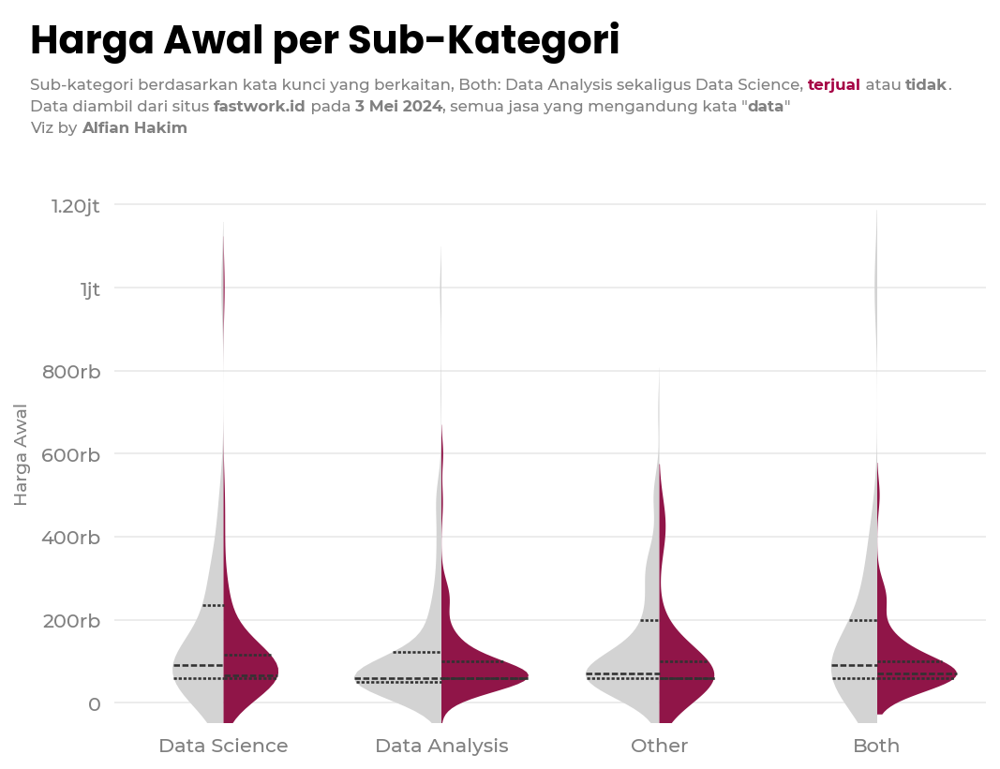

In [67]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=cust_df_z.loc[(cust_df_z['starting_price_z']<3) & (cust_df_z['starting_price_z']>-3)],
               x="subcat", y="starting_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-50000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Awal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Awal per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 2 Std Dev

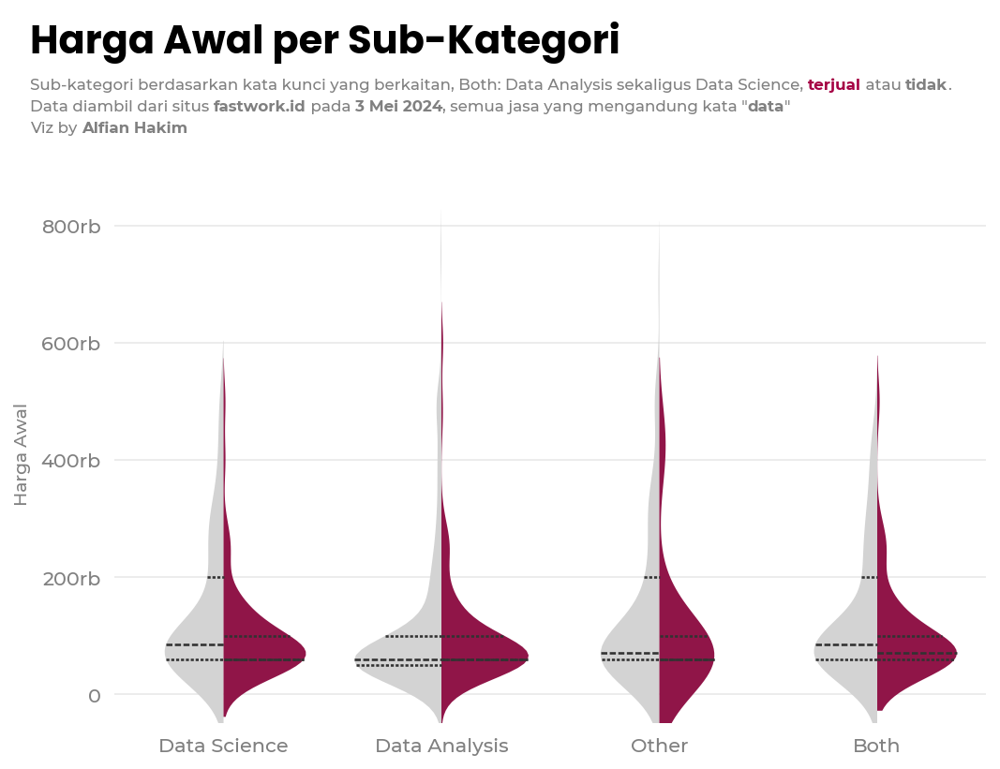

In [68]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=cust_df_z.loc[(cust_df_z['starting_price_z']<2) & (cust_df_z['starting_price_z']>-2)],
               x="subcat", y="starting_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-50000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Awal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Awal per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 1 Std Dev

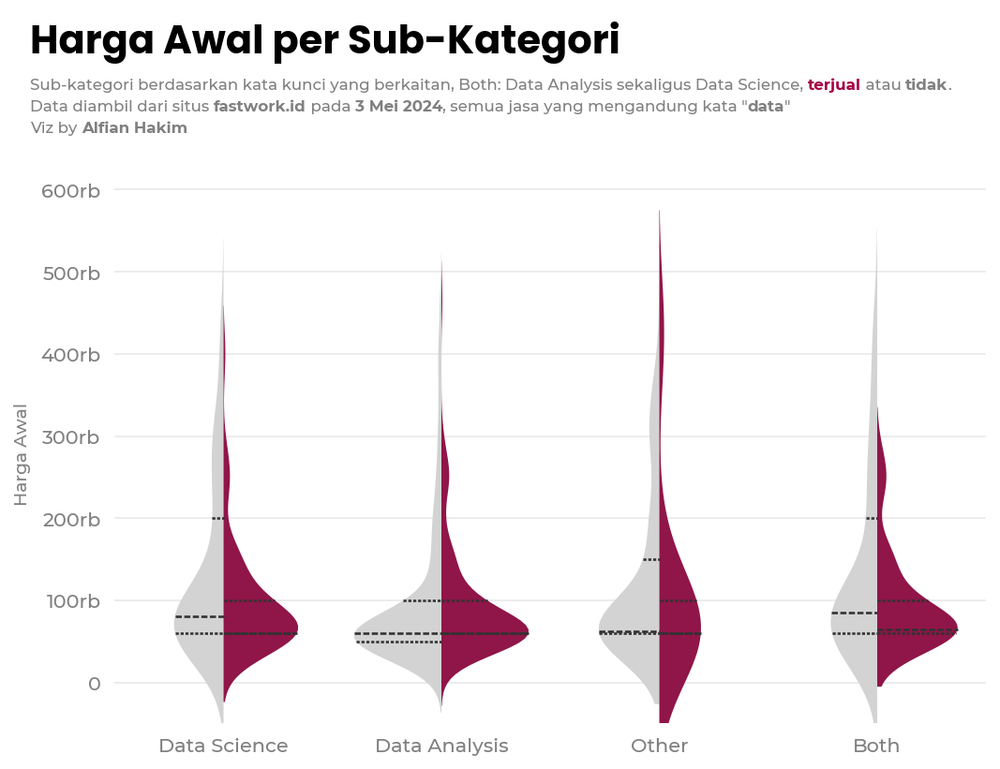

In [69]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=cust_df_z.loc[(cust_df_z['starting_price_z']<1) & (cust_df_z['starting_price_z']>-1)],
               x="subcat", y="starting_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-50000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Awal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Awal per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

### Max Price

- apakah ada outlier?

In [70]:
print("""Max price descriptive statistics:
- Mean: Rp{:,}
- Std. Deviation: Rp{:,}
- Min: Rp{:,}
- P25: Rp{:,}
- P50: Rp{:,}
- P75: Rp{:,}
- Max: Rp{:,}""".format(df_services['max_price'].mean(),
                          df_services['max_price'].std(),
                          df_services['max_price'].min(),
                          df_services['max_price'].quantile(0.25),
                          df_services['max_price'].median(),
                          df_services['max_price'].quantile(0.75),
                          df_services['max_price'].max()))

Max price descriptive statistics:
- Mean: Rp204,319.8657384386
- Std. Deviation: Rp449,345.8347233097
- Min: Rp25,000
- P25: Rp50,000.0
- P50: Rp75,000.0
- P75: Rp150,000.0
- Max: Rp10,000,000


In [71]:
df_z = df_services.copy()
std = df_z['max_price'].std()
mean = df_z['max_price'].mean()
df_z['max_price_z'] = (df_z['max_price']-mean)/std

In [72]:
df_z.loc[(df_z['max_price_z']>=3) | (df_z['max_price_z']<=-3)]

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time,general_category,description_translated,title_translated,title_desc_translated,is_analytics,is_sold,max_price_z
1,https://fastwork.id/user/pieterkd/data-analysis-45497901,pieterkd,data-analysis,https://storage.googleapis.com/fastwork-static/00983474-6e55-4ee5-ba84-5e4a3b63980d.jpg,"Data Science, Machine Learning, Deep Learning Engineer",60000,22,4.9,13,48.0,0,1,0,0,"Hello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills",22,3,2500000,2.0,7.0,data-analysis,"Hello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills","Data Science, Machine Learning, Deep Learning Engineer","Data Science, Machine Learning, Deep Learning Engineer\n\nHello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills",Data Analytics,1,5.108938
47,https://fastwork.id/user/jdkmpro/data-analysis-11338132,jdkmpro,data-analysis,https://storage.googleapis.com/fastwork-static/cdb9b3f4-2d29-42fa-9195-7cfc0cf25cd2.jpg,"Data scientist Menggunakan jupyter notebooks in python,Google Colab, R,",28

In [73]:
df_z.loc[(df_z['max_price_z']>=3) | (df_z['max_price_z']<=-3)].shape[0]

28

In [74]:
std

449345.8347233097

- terdapat beberapa 28 outlier jika berdasarkan 3x std dev

#### Viz per Kategori

##### 3 Std Dev

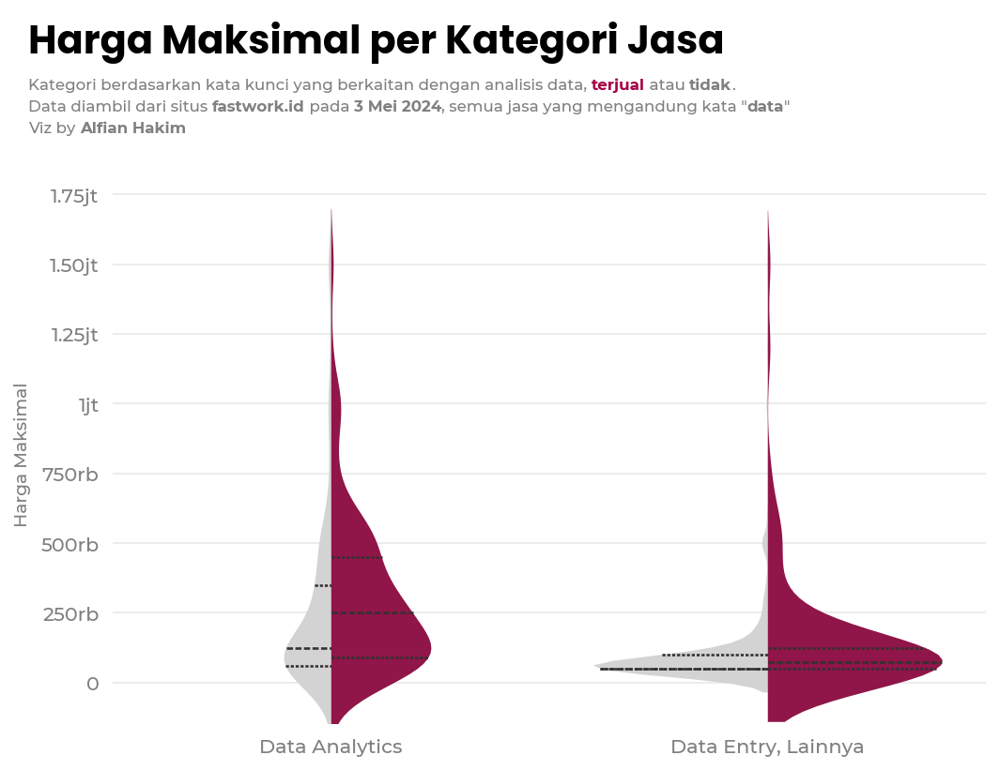

In [75]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_z.loc[(df_z['max_price_z']<3) & (df_z['max_price_z']>-3)],
               x="is_analytics", y="max_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-150000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Maksimal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Maksimal per Kategori Jasa',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 2 Std Dev

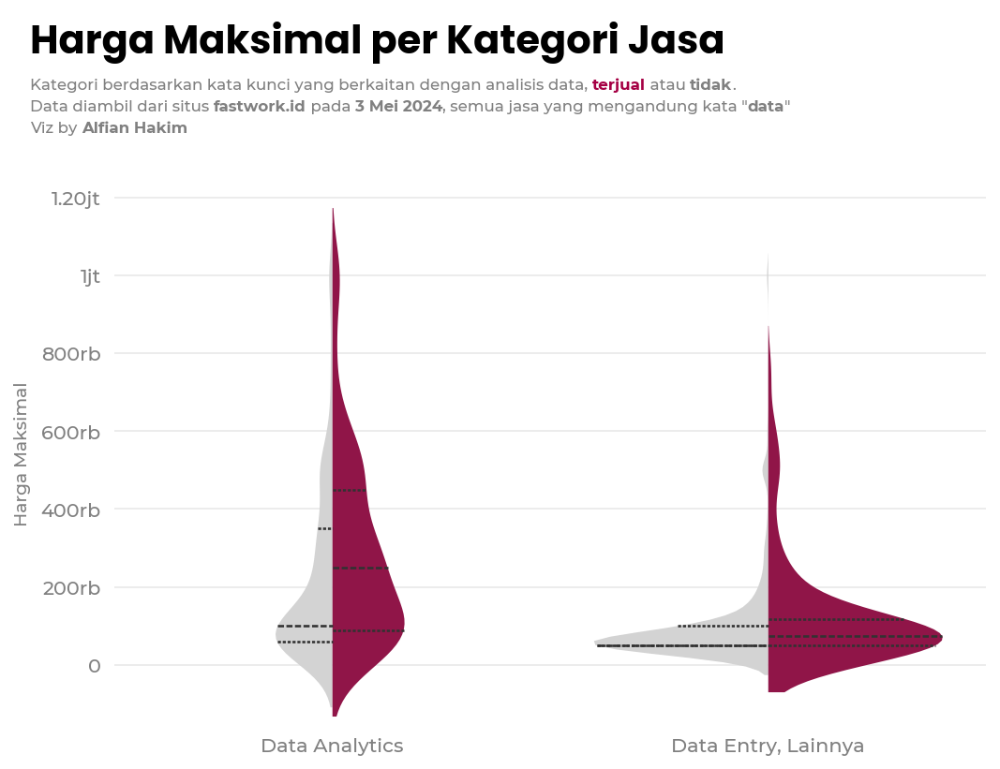

In [76]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_z.loc[(df_z['max_price_z']<2) & (df_z['max_price_z']>-2)],
               x="is_analytics", y="max_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-150000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Maksimal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Maksimal per Kategori Jasa',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 1 Std Dev

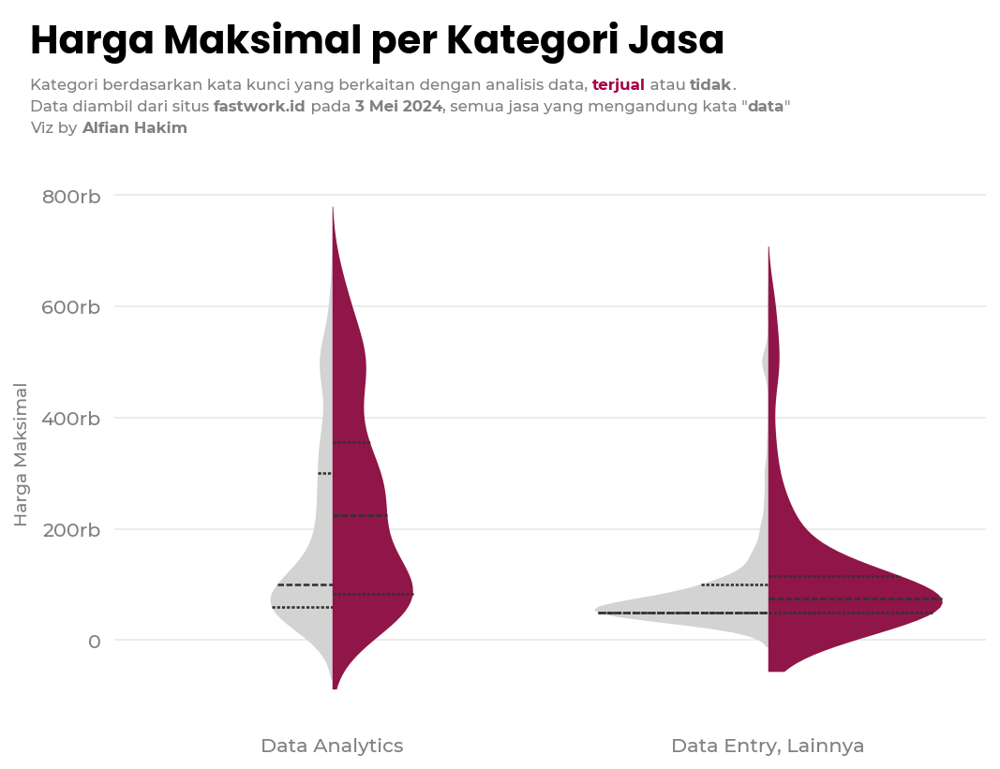

In [77]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_z.loc[(df_z['max_price_z']<1) & (df_z['max_price_z']>-1)],
               x="is_analytics", y="max_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-150000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Maksimal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Maksimal per Kategori Jasa',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Kategori berdasarkan kata kunci yang berkaitan dengan analisis data, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

- rata2 harga maksimal di kategori data analytics ada di 200rban utk yg terjual, sedangkan yg tidak terjual ada di 100rb an

#### Viz per Subkategori Data Analytcics

- apakah ada outlier?

In [78]:
print("""Max price descriptive statistics:
- Mean: Rp{:,}
- Std. Deviation: Rp{:,}
- Min: Rp{:,}
- P25: Rp{:,}
- P50: Rp{:,}
- P75: Rp{:,}
- Max: Rp{:,}""".format(df_analytics['max_price'].mean(),
                          df_analytics['max_price'].std(),
                          df_analytics['max_price'].min(),
                          df_analytics['max_price'].quantile(0.25),
                          df_analytics['max_price'].median(),
                          df_analytics['max_price'].quantile(0.75),
                          df_analytics['max_price'].max()))

Max price descriptive statistics:
- Mean: Rp366,527.043219076
- Std. Deviation: Rp662,554.2021350649
- Min: Rp25,000
- P25: Rp60,000.0
- P50: Rp150,000.0
- P75: Rp417,499.5
- Max: Rp10,000,000


In [79]:
df_z = df_analytics.copy()
std = df_z['max_price'].std()
mean = df_z['max_price'].mean()
df_z['max_price_z'] = (df_z['max_price']-mean)/std

In [80]:
df_z.loc[(df_z['max_price_z']>=3) | (df_z['max_price_z']<=-3)]

,url,user,category,image_url,title,starting_price,sell_count,avg_rating,n_rating,response_time,badge_pro,badge_banyak_rehire,badge_bayar_bertahap,badge_specialist,description,purchase_count,n_packages,max_price,min_delivery_time,max_delivery_time,general_category,description_translated,title_translated,title_desc_translated,is_data_science,is_data_analysis,is_both,is_other,is_sold,max_price_z
1,https://fastwork.id/user/pieterkd/data-analysis-45497901,pieterkd,data-analysis,https://storage.googleapis.com/fastwork-static/00983474-6e55-4ee5-ba84-5e4a3b63980d.jpg,"Data Science, Machine Learning, Deep Learning Engineer",60000,22,4.9,13,48.0,0,1,0,0,"Hello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills",22,3,2500000,2.0,7.0,data-analysis,"Hello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills","Data Science, Machine Learning, Deep Learning Engineer","Data Science, Machine Learning, Deep Learning Engineer\n\nHello Customer,\n\nWhether you need help with machine learning, nlp, deep learning or any other aspect of AI, I have the expertise and knowledge to help you succeed.\n\nPlease contact me with your task details before ordering.\n\nMachine Learning Services:\n\n😀Data Science, ML, Deep Learning\nObject Detection\nObject Recognition\nRegression\nVisualization\nText Classification\nArtificial Intelligence\nNatural Language Processing (NLP)\nSupervised / Unsupervised Learning\nSegmentation\n\n😁Tools / Frameworks:\nPython\nJupyter Notebook\nSpyder\nTensorflow\nKeras\nPyTorch\nScikit-learn\nPandas\nNLTK\nOpenCV\n\nMy services are designed to be fast, reliable, and affordable, with a focus on delivering high-quality results that meet your specific needs.\n\nPlease note that I'll never accept payments out of Fastwork and we may have a virtual meeting ONLY for screen sharing and resolving any issues in your excel or google spreadsheet.\n\nContact to give me chance to show my skills",1,0,0,0,1,3.220073
25,https://fastwork.id/user/jdkmpro/data-analysis-11338132,jdkmpro,data-analysis,https://storage.googleapis.com/fastwork-static/cdb9b3f4-2d29-42fa-9195-7cfc0cf25cd2.jpg,"Data scientist Menggunakan jupyter notebooks 

In [81]:
df_z.loc[(df_z['max_price_z']>=3) | (df_z['max_price_z']<=-3)].shape[0]

12

##### 3 Std Dev

In [82]:
# customized df
cust_df_z = pd.DataFrame()

for col in subkat_cols+['is_other','is_both']:
    df_temp = df_z.loc[df_z[col]==1]
    df_temp['subcat'] = col.replace('is_','').replace('_',' ').title()
    cust_df_z = pd.concat([cust_df_z, df_temp])

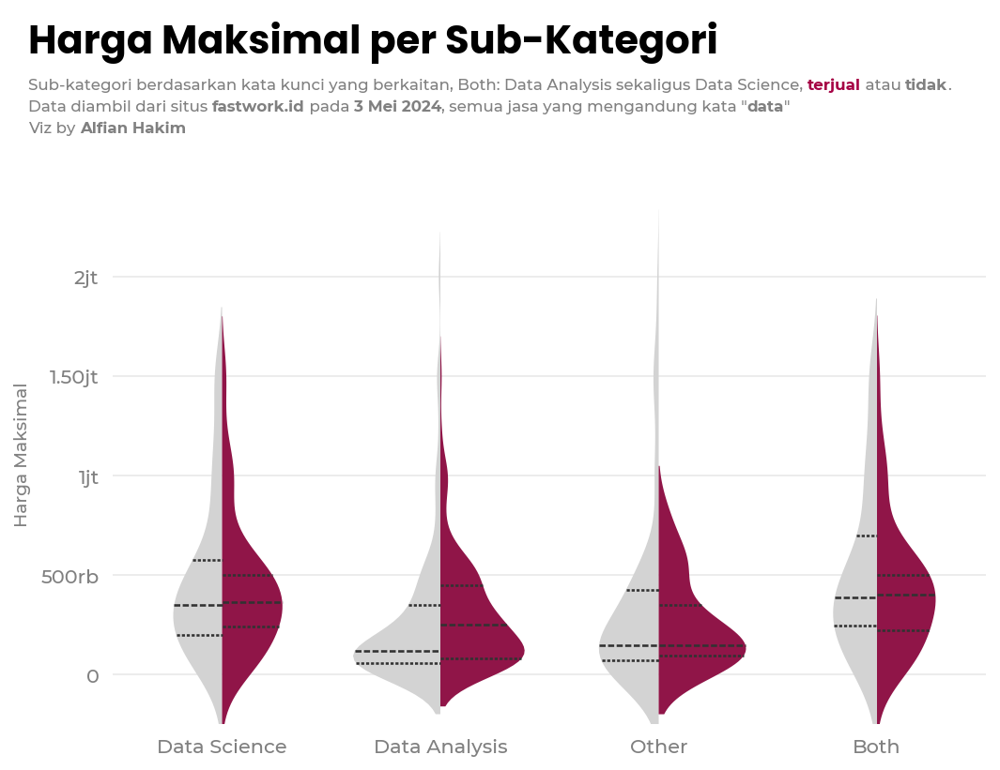

In [83]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=cust_df_z.loc[(cust_df_z['max_price_z']<3) & (cust_df_z['max_price_z']>-3)],
               x="subcat", y="max_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-250000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Maksimal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Maksimal per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 2 Std Dev

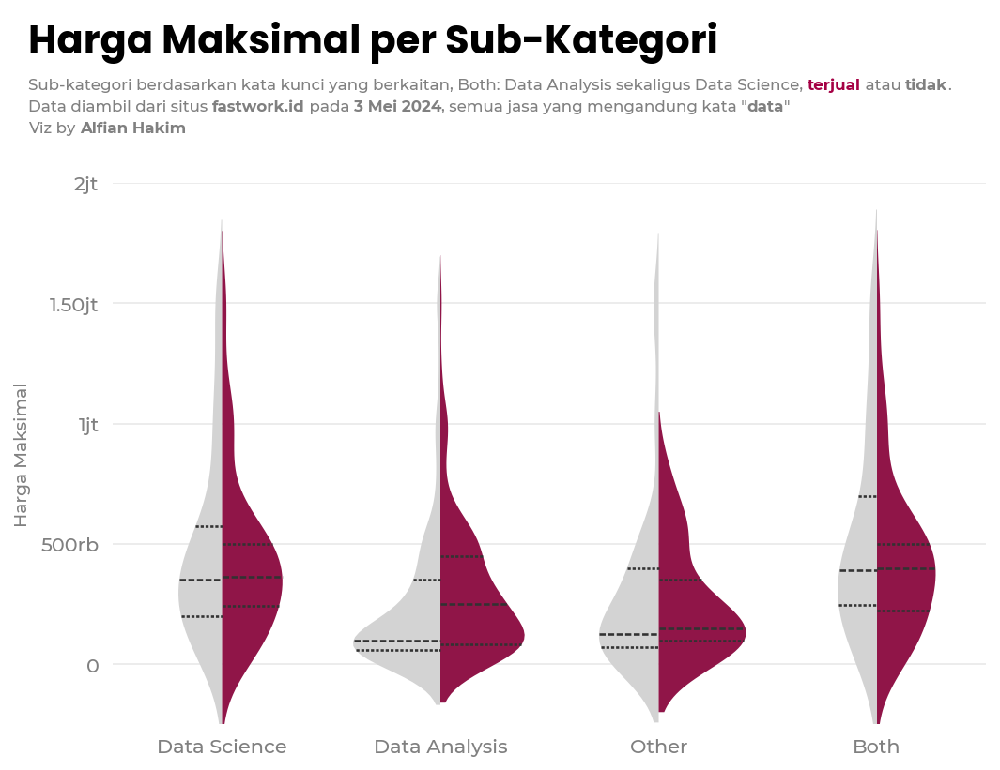

In [84]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=cust_df_z.loc[(cust_df_z['max_price_z']<2) & (cust_df_z['max_price_z']>-2)],
               x="subcat", y="max_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-250000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Maksimal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Maksimal per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 1 Std Dev

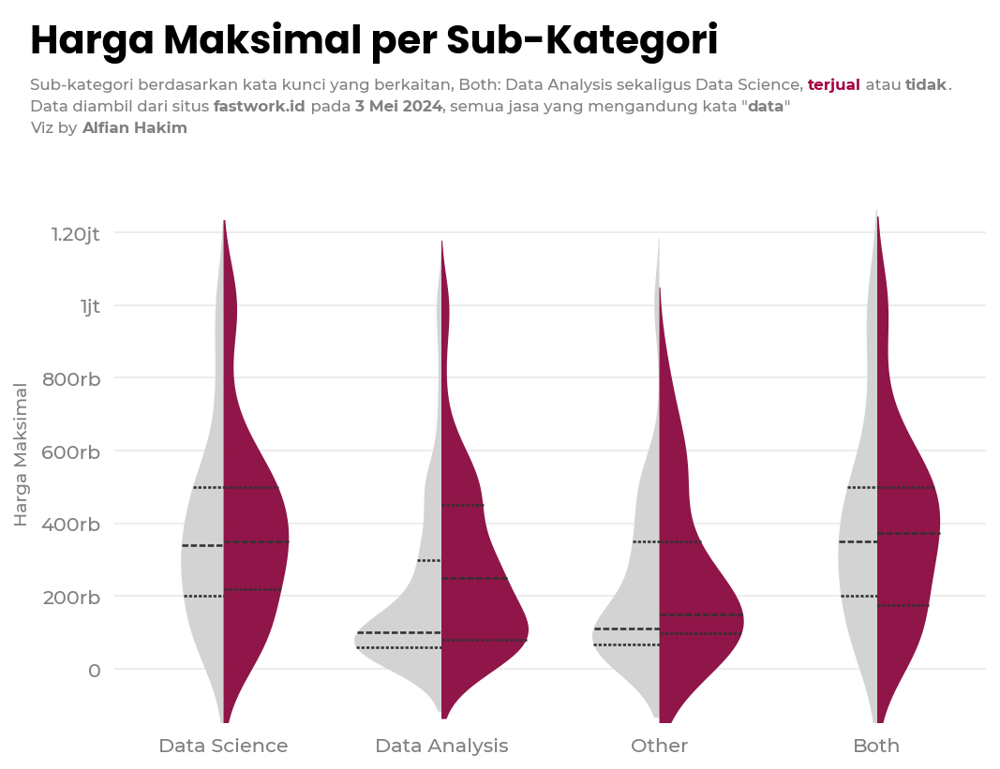

In [85]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=cust_df_z.loc[(cust_df_z['max_price_z']<1) & (cust_df_z['max_price_z']>-1)],
               x="subcat", y="max_price",
               hue="is_sold", split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-150000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga Maksimal', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga Maksimal per Sub-Kategori',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Sub-kategori berdasarkan kata kunci yang berkaitan, Both: Data Analysis sekaligus Data Science, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

## Analisis #3 Paket

### Jumlah Paket Jasa Data Analytics

In [86]:
df_analytics['n_packages'].value_counts()

n_packages
3    280
1    240
2    149
4      2
Name: count, dtype: int64

In [87]:
df_agg_paket = df_analytics.groupby(['n_packages'], as_index=False).agg({'url':'nunique'}).rename({'url':'count'}, axis=1).sort_values('count').reset_index(drop=True)
df_agg_paket_sold = df_analytics.loc[df_analytics['purchase_count']>0].groupby(['n_packages'], as_index=False).agg({'url':'nunique'}).rename({'url':'count_sold'}, axis=1).sort_values('count_sold').reset_index(drop=True)
df_agg_paket = pd.merge(df_agg_paket, df_agg_paket_sold)

df_agg_paket = df_agg_paket.loc[df_agg_paket['n_packages']!=4].reset_index(drop=True)
df_agg_paket

,n_packages,count,count_sold
0,2,149,30
1,1,240,51
2,3,280,99


#### Viz Jumlah Paket

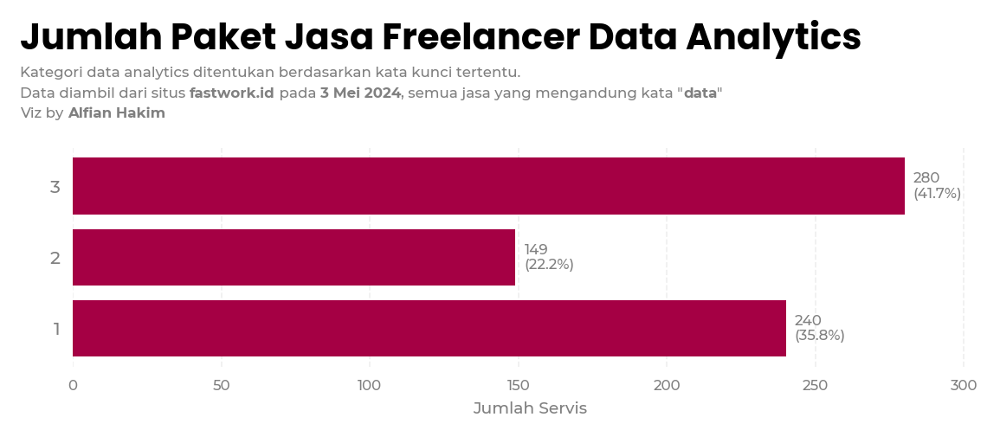

In [88]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars = ax1.barh(df_agg_paket['n_packages'], df_agg_paket['count'], color=b_colors[0])

_, xmax = ax1.get_xlim()

for bar in bars:
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{width:,}\n({width / df_analytics.shape[0] * 100:.1f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c='grey', fontsize=8)



# ax1.set_yticklabels(df_agg_paket['n_packages'], rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


x_min = 0
x_max = df_agg_paket['count'].max()*1.1

ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Jumlah Servis', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.05, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Jumlah Paket Jasa Freelancer Data Analytics',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98-0.03,
         fontsize = 8,
         s = 'Kategori data analytics ditentukan berdasarkan kata kunci tertentu.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


#### Viz Persentase Terjual

In [89]:
df_agg_paket['count_unsold'] = df_agg_paket['count']-df_agg_paket['count_sold']

for status in ['sold', 'unsold']:
    df_agg_paket[f'{status}_pct'] = df_agg_paket[f'count_{status}']/df_agg_paket['count']*100

df_agg_paket = df_agg_paket.sort_values('sold_pct').reset_index(drop=True)

df_agg_paket

,n_packages,count,count_sold,count_unsold,sold_pct,unsold_pct
0,2,149,30,119,20.134228,79.865772
1,1,240,51,189,21.250000,78.750000
2,3,280,99,181,35.357143,64.642857


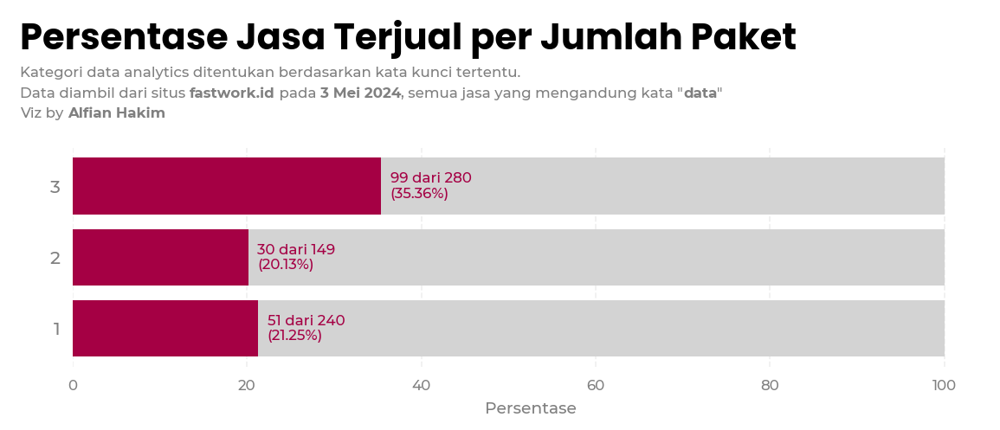

In [90]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars_1 = ax1.barh(df_agg_paket['n_packages'],
                  df_agg_paket['sold_pct'], color=b_colors[0])
bars_2 = ax1.barh(df_agg_paket['n_packages'], df_agg_paket['unsold_pct'],
                  left=df_agg_paket['sold_pct'], color='lightgray')

_, xmax = ax1.get_xlim()

for i, bar in enumerate(bars_1):
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{df_agg_paket.iloc[i]['count_sold']:.0f} dari {df_agg_paket.iloc[i]['count']:.0f}\n({width:.2f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c=b_colors[0], fontsize=8)



# ax1.set_yticklabels(df_agg_paket['subcat'].apply(lambda x:x.replace('is_','').replace('_',' ').title()), rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


# x_min = 0
# x_max = df_agg_category['count'].max()*1.1

# ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Persentase', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.05, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Persentase Jasa Terjual per Jumlah Paket',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98-0.03,
         fontsize = 8,
         s = 'Kategori data analytics ditentukan berdasarkan kata kunci tertentu.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


- dapat diketahui bahwa jasa freelance data analytics cenderung memiliki jumlah 3 paket
- jasa 3 paket ini juga memiliki persentase terjual lebih tinggi dibanding jasa dgn jumlah paket lain

### Harga pada Jasa dengan 3 Paket

In [91]:
df_3_paket = df_analytics.loc[df_analytics['n_packages']==3].reset_index(drop=True)

In [92]:
l_packages = []
for url, info in d_services.items():
  if info != "Error":

    for package in info['packages']:
      d_package = {}
      d_package['url'] = url
      d_package['title'] = info['title']
      d_package['package_title'] = package['title']
      d_package['description'] = package['description']
      d_package['price'] = package['price']
      d_package['delivery_time'] = package['delivery_time']

      l_packages.append(d_package)

In [93]:
df_packages = pd.DataFrame(l_packages)
df_packages = df_packages.sort_values(['url','price']).reset_index(drop=True)
df_packages['package_number'] = df_packages.groupby(df_packages['url'].ne(df_packages['url'].shift()).cumsum())['price'].rank().astype(int)

In [94]:
df_packages.head()

,url,title,package_title,description,price,delivery_time,package_number
0,https://fastwork.id/user/00ulvi/data-analysis-41519534,Olah Data SPSS untuk TUGAS AKHIR,Paket Silver,File Excel tabulasi data\nHasil analisis univariat dan bivariat \nHasil interpretasi analisis ditulis dalam bentuk word\nRevisi 1 kali,165000,3.0,1
1,https://fastwork.id/user/00ulvi/data-analysis-41519534,Olah Data SPSS untuk TUGAS AKHIR,Paket Gold,"File Excel tabulasi data\nHasil analisis univariat, bivariat dan multivariat\nHasil interpretasi analisis ditulis dalam bentuk word\nManipulasi data +50k\nRevisi 1 kali",330000,3.0,2
2,https://fastwork.id/user/00ulvi/data-analysis-41519534,Olah Data SPSS untuk TUGAS AKHIR,Paket Platinum,"File Excel tabulasi data\nHasil analisis univariat, bivariat dan multivariat\nHasil interpretasi analisis ditulis dalam bentuk word\nManipulasi data\nRevisi 1 kali\ndll",465000,3.0,3
3,https://fastwork.id/user/079517/data-analysis-29666122,Jasa Pembuatan (Pengolahan) Data Menggunakan Ms. Excel,Pembuatan dan Pengolahan Data,Data yang tersusun rapih dan akurat menggunakan rumus Ms. Excel.\n\n**Biaya tergantung pada tingkat komleksitas data klien.,100000,2.0,1
4,https://fastwork.id/user/0liv09/writing-translation-other-58439879,"Data Entry (Ms. Excel, Word, Spreedsheet)",Paket Harian,1. Hasil sesuai dengan permintaan klien\n2. Format file sesuai dengan permintaan klien\n3. Waktu pengerjaan 24 jam atau kurang atau sesuai kesepakatan\n4. Harga tergantung kerumitan dan sesuai dengan kesepakatan\n5. Revisi hingga sesuai,60000,1.0,1


In [95]:
df_packages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3785 entries, 0 to 3784
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   url             3785 non-null   object 
 1   title           3785 non-null   object 
 2   package_title   3785 non-null   object 
 3   description     3785 non-null   object 
 4   price           3785 non-null   int64  
 5   delivery_time   3775 non-null   float64
 6   package_number  3785 non-null   int64  
dtypes: float64(1), int64(2), object(4)
memory usage: 207.1+ KB


In [96]:
df_packages = pd.merge(df_analytics.loc[df_analytics['n_packages']==3][['url','is_sold']], df_packages)

In [97]:
df_packages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 840 entries, 0 to 839
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   url             840 non-null    object 
 1   is_sold         840 non-null    int64  
 2   title           840 non-null    object 
 3   package_title   840 non-null    object 
 4   description     840 non-null    object 
 5   price           840 non-null    int64  
 6   delivery_time   832 non-null    float64
 7   package_number  840 non-null    int64  
dtypes: float64(1), int64(3), object(4)
memory usage: 52.6+ KB


In [98]:
df_packages['url'].nunique()

280

- apakah ada outlier?

In [99]:
print("""Package price descriptive statistics:
- Mean: Rp{:,}
- Std. Deviation: Rp{:,}
- Min: Rp{:,}
- P25: Rp{:,}
- P50: Rp{:,}
- P75: Rp{:,}
- Max: Rp{:,}""".format(df_packages['price'].mean(),
                          df_packages['price'].std(),
                          df_packages['price'].min(),
                          df_packages['price'].quantile(0.25),
                          df_packages['price'].median(),
                          df_packages['price'].quantile(0.75),
                          df_packages['price'].max()))

Package price descriptive statistics:
- Mean: Rp333,738.8107142857
- Std. Deviation: Rp610,468.281414401
- Min: Rp19,000
- P25: Rp60,000.0
- P50: Rp150,000.0
- P75: Rp350,000.0
- Max: Rp10,000,000


In [100]:
df_z = df_packages.copy()
std = df_z['price'].std()
mean = df_z['price'].mean()
df_z['price_z'] = (df_z['price']-mean)/std

In [101]:
df_z.loc[(df_z['price_z']>=3) | (df_z['price_z']<=-3)]

,url,is_sold,title,package_title,description,price,delivery_time,package_number,price_z
5,https://fastwork.id/user/pieterkd/data-analysis-45497901,1,"Data Science, Machine Learning, Deep Learning Engineer",Paket Standard,"Complex machine learning model with data visualization\nResearch, data preprocessing, model creation, fine tuning, source code, model documentation",2500000,5.0,3,3.548524
41,https://fastwork.id/user/jdkmpro/data-analysis-11338132,1,"Data scientist Menggunakan jupyter notebooks in python,Google Colab, R,",PREMIUM,"Cleaning, Visualization, Model Building, Validation.\n\n1. File Pengiriman sesuai dengan \n permintaan client.\n2. Revisi 4x",2800000,8.0,3,4.039950
88,https://fastwork.id/user/bangbegs/infographics-73362423,0,Data Bercerita! Desain infografis +bonus copywriting,Desain Infografis Premium,"File infografis sebanyak 5 desain dalam bentuk PNG, masing-masing dalam 3 kali revisi.",2500000,7.0,2,3.548524
89,https://fastwork.id/user/bangbegs/infographics-73362423,0,Data Bercerita! Desain infografis +bonus copywriting,Desain Infografis Customize,"Desain infografis kompleks dan customize sesuai kebutuhan Anda, dikerjakan dengan waktu yang lebih cepat.",5000000,3.0,3,7.643741
128,https://fastwork.id/user/kimgeovedi/data-analysis-78337571,0,Data analysis dan visualisasi,Paket Konsultasi dan Pemrosesan Data,"\n\n- **Layanan:**\n - Konsultasi Proses Data: Bantuan dalam perencanaan dan desain penelitian, pengumpulan data, dan penyusunan data.\n - Analisis Statistik Mendalam: Analisis data yang komprehensif dengan interpretasi mendalam dan saran untuk pengambilan keputusan.\n - Pelatihan Penggunaan Alat Analisis: Bimbingan dalam menggunakan alat dan teknik analisis data yang sesuai.\n\n- **Harga: Tergantung pada tingkat konsultasi dan kompleksitas proyek. Mulai dari Rp2.500.000 - Rp5.000.000 per proyek.**",2500000,7.0,3,3.548524
371,https://fastwork.id/user/bobbyilham/data-analysis-80457511,1,ANALISIS DATA DAN VISUALISASI MENGGUNAKAN MICROSOFT POWER BI,Pembuatan Visualisasi Power BI (Include: Source Code DAX),Link embed untuk diterapkan di website perusahaan & File Power BI .pbix\n\nS&K:\n- Revisi formula dan KPI maksimal 5x\n- Revisi desain maksimal 2x,2750000,14.0,3,3.958045
422,https://fastwork.id/user/idameika/data-analysis-98744723,0,"Analysis Data / Visualisasi Data Excel, R, Tableau",Advanced,1. Sesi diskusi untuk mengenali permasalahan\n2. Analisa tingkat lanjut\n3. Hasil laporan analisa data\n4. Konsultasi dan pemberian saran,2500000,5.0,3,3.548524
560,https://fastwork.id/user/batues/data-analysis-14597541,0,CONVERT YOUR DATA INTO INFORMATION,Ultimate Data Analysis,Up to 10 data sources (online & offline source - manual & automatic update)\nUp to 20 processed information\nUp to 5 dashboards,5000000,10.0,3,7.643741
570,https://fastwork.id/user/hafidhatim/data-analysis-56335964,0,Full Data Architecture Consultation and Cost Optimization,Data Pipeline Development and Consultation,"Introducing our Data Pipeline Development and Consultation services, designed to empower your organization with efficient and seamless data workflows. With our expertise and industry knowledge, we provide comprehensive solutions tailored to your specific needs. \n\nusers receive the following benefits:\n\n- Customized Data Pipelines\n- Efficient Data Integration\n- Scalable and Reliable Infrastructure\n- Enhanced Data Quality\n- Expert Consultation\n- Documentations",3750000,5.0,1,5.596132
571,https://fastwork.id/user/hafidhatim/data-analysis-56335964,0,Full Data Architecture Consultation and Cost Optimization,Data Architecture Health Check,"With this service, users gain valuable insights into their data infrastructure, identifying areas for improvement and optimizing data management processes. Through the Data Architecture Health Check, \n\nusers receive the following benefits:\n\n- Evaluation of Data Infrastructure\n- Identification of Optimization Opportunities\n- Data Quality and Integrity Assessment\n- Security and Compliance R

In [102]:
df_z.loc[(df_z['price_z']>=3) | (df_z['price_z']<=-3)].shape[0]

12

#### Viz Harga Paket

##### 3 Std Dev

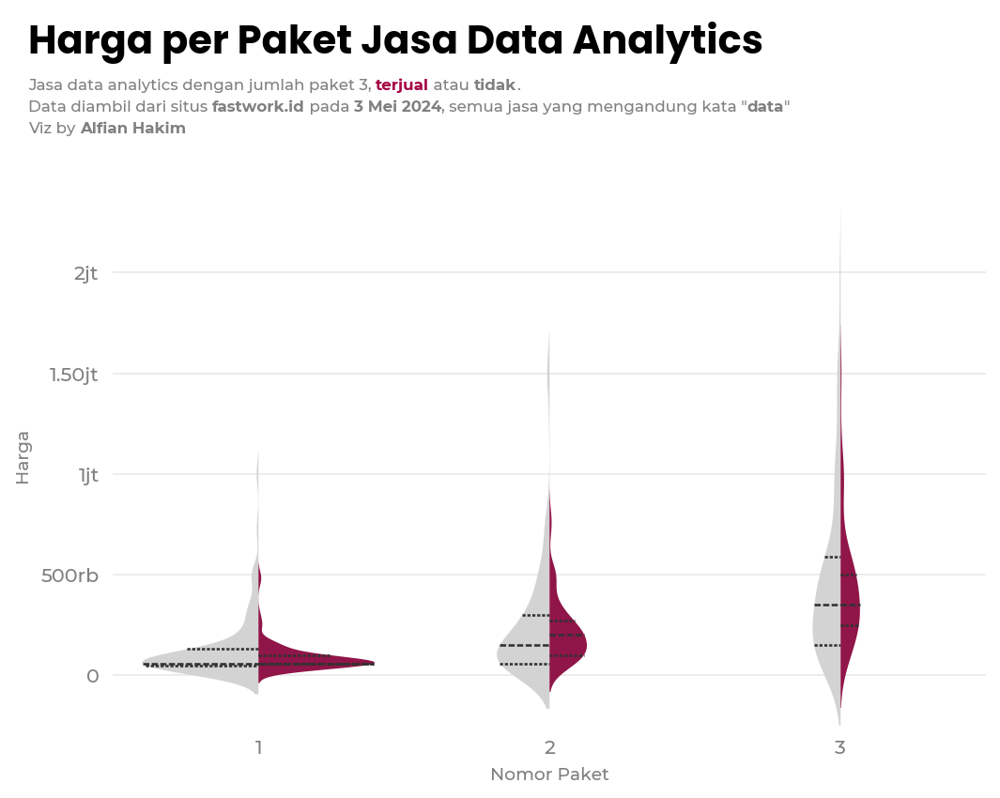

In [103]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_packages.loc[~df_packages['url'].isin(df_z.loc[(df_z['price_z']>=3) | (df_z['price_z']<=-3),'url'])],
               x='package_number',
               y='price',
               hue='is_sold',
               split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-250000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Nomor Paket', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga per Paket Jasa Data Analytics',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Jasa data analytics dengan jumlah paket 3, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 2 Std Dev

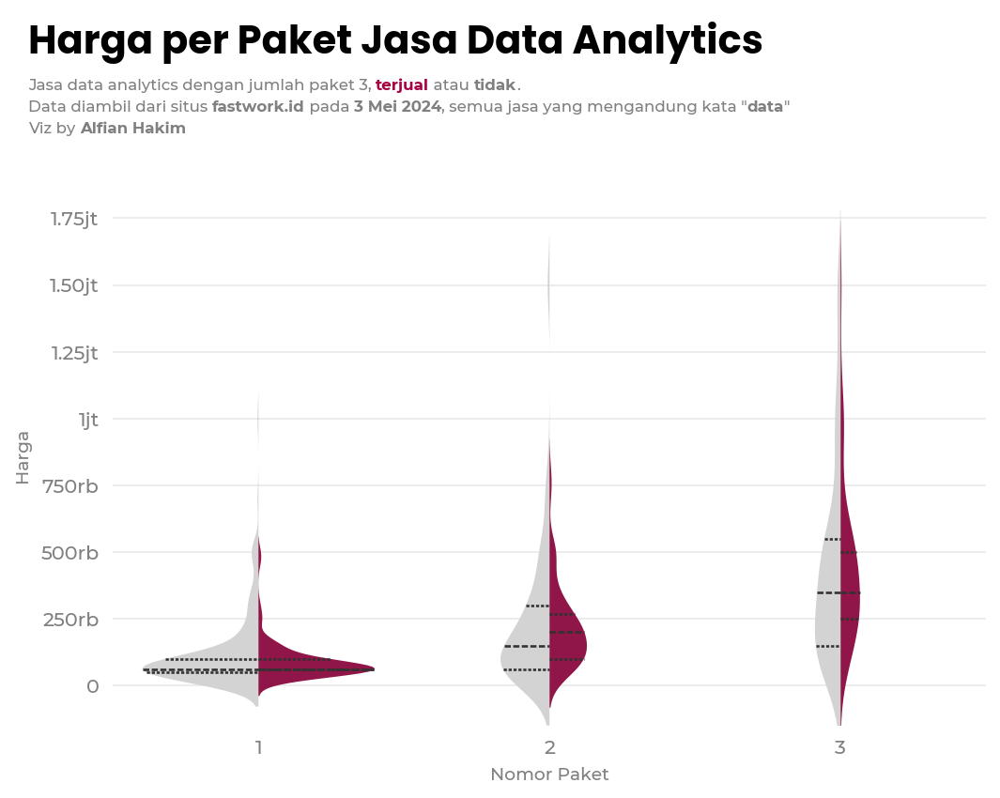

In [104]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_packages.loc[~df_packages['url'].isin(df_z.loc[(df_z['price_z']>=2) | (df_z['price_z']<=-2),'url'])],
               x='package_number',
               y='price',
               hue='is_sold',
               split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-150000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Nomor Paket', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga per Paket Jasa Data Analytics',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Jasa data analytics dengan jumlah paket 3, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

##### 1 Std Dev

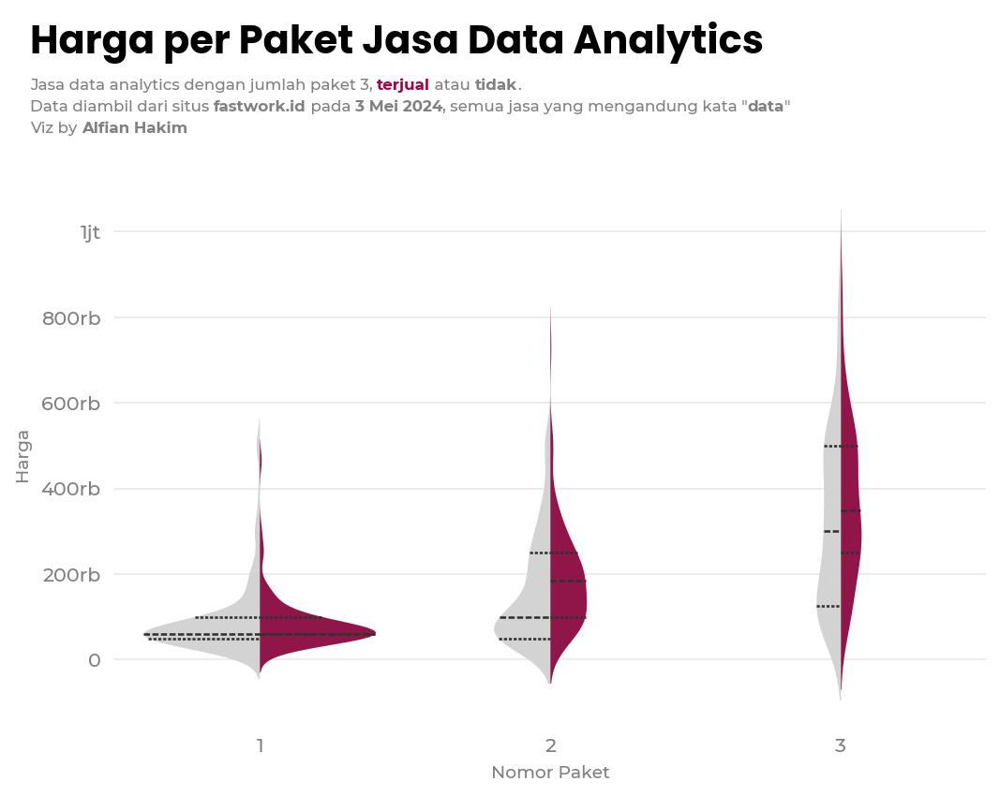

In [105]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 5), dpi=150)

sns.violinplot(data=df_packages.loc[~df_packages['url'].isin(df_z.loc[(df_z['price_z']>=1) | (df_z['price_z']<=-1),'url'])],
               x='package_number',
               y='price',
               hue='is_sold',
               split=True, inner="quart",
               palette={1: b_colors[0], 0: "lightgray"},
              #  linewidth=0,
               ax=ax1)

ax1.set_ylim(bottom=-150000)

for collection in ax1.collections:
    collection.set_edgecolor("none")

# Turn off the legend
ax1.legend_.remove()

# Add a grid
# ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
ax1.yaxis.grid(True, color='lightgray',alpha=0.5)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Nomor Paket', labelpad=5, weight='medium', c='grey', fontsize=9)
ax1.set_ylabel('Harga', labelpad=5, weight='medium', c='grey', fontsize=9)

plt.gca().yaxis.set_major_formatter(FuncFormatter(format_numbers))

fig_text(x = 0.05, y = 1+0.05,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Harga per Paket Jasa Data Analytics',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.05, y = 0.98+0.05,
         fontsize = 8,
         s = 'Jasa data analytics dengan jumlah paket 3, <terjual> atau <tidak>.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"color":b_colors[0],"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

plt.show()

### Kata Kunci pada Jasa dengan 3 Paket

In [106]:
df_packages['description_translated'] = df_packages.apply(lambda row: trans_to_en(row['description']), axis=1)
df_packages['package_title_translated'] = df_packages.apply(lambda row: trans_to_en(row['package_title']), axis=1)

df_packages['package_title_desc_translated'] = df_packages['package_title_translated']+'\n\n'+df_packages['description_translated']

##### Viz Word Cloud per Paket

In [107]:
x, y = np.ogrid[:800, :800]
mask = (x - 400) ** 2 + (y - 400) ** 2 > 480 ** 2
mask = 255 * mask.astype(int)

text_left = " ".join(df_packages.loc[df_packages['package_number']==1,'package_title_translated'].apply(lambda x:x.lower()).tolist())

wc_left = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func("black")
  )
wc_left.generate(text_left)

text_center = " ".join(df_packages.loc[df_packages['package_number']==2,'package_title_translated'].apply(lambda x:x.lower()).tolist())

wc_center = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func("black")
  )
wc_center.generate(text_center)

text_right = " ".join(df_packages.loc[df_packages['package_number']==3,'package_title_translated'].apply(lambda x:x.lower()).tolist())

wc_right = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func(b_colors[0])
  )
wc_right.generate(text_right)

(0.0, 12.0, 0.0, 4.5)

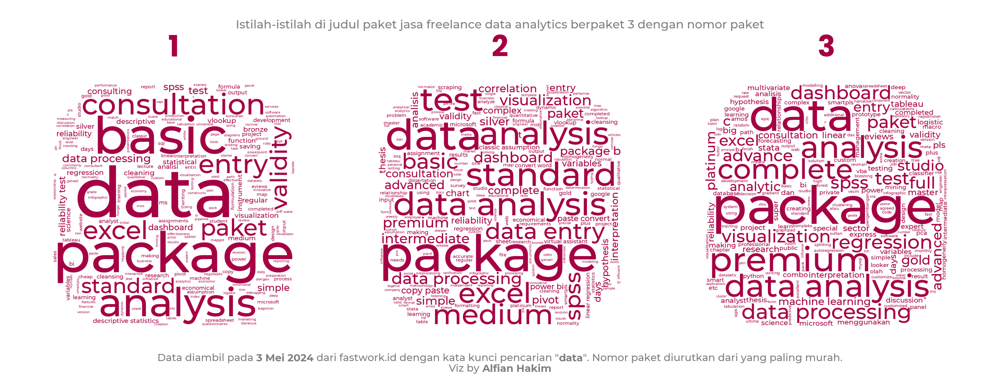

In [108]:
fig, ax = plt.subplots(figsize=(12,4.5), dpi=400)

ax.set_xlim(0, 12)
ax.set_ylim(0, 4.5)

# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([0.5, 0.5])
ax_point_2 = DC_to_NFC([3.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([0.5, 0.6])

left_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

left_ax.axis("off")
left_ax.imshow(wc_left, interpolation = "bilinear")




# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([4.5, 0.5])
ax_point_2 = DC_to_NFC([7.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([4.5, 0.6])

center_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

center_ax.axis("off")
center_ax.imshow(wc_center, interpolation = "bilinear")


# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([8.5, 0.5])
ax_point_2 = DC_to_NFC([11.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([8.5, 0.6])

right_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

right_ax.axis("off")
right_ax.imshow(wc_right, interpolation = "bilinear")

ax.annotate(
    xy=(6, 4.25),
    text="Istilah-istilah di judul paket jasa freelance data analytics berpaket 3 dengan nomor paket",
    ha='center',
    va='bottom',
    color='gray',
    fontsize = 8,
    # font="Poppins",
    weight="medium"
)

ax_text(x=2, y= 4.2,
                       s = '<1>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 4.2,
                       s = '<2>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=10, y= 4.2,
                       s = '<3>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 0.15,
                       s = 'Data diambil pada <3 Mei 2024> dari fastwork.id dengan kata kunci pencarian "<data>". Nomor paket diurutkan dari yang paling murah.',
                       highlight_textprops = [
                           {"weight":"bold"},
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='bottom', weight="medium",
                       ax=ax)

ax_text(x=6, y= 0.14,
                       s = 'Viz by <Alfian Hakim>',
                       highlight_textprops = [
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='top', weight="medium",
                       ax=ax)

ax.axis("off")

- terlihat bahwa di paket 1 kata konsultasi banyak muncul, dan juga kata basic
- pada paket 2 muncul standard, medium, intermediate
- paket 3 muncul kata premium, full, platinum, gold, complete

## Analisis #4 Profil Freelancer

In [109]:
url = 'https://github.com/ilmuneraka/fastwork-analysis/raw/main/{}_{}%20Fastwork%20Profiles.pickle'.format(today_str, "data")

response = requests.get(url)
response.raise_for_status()  # Ensure we notice bad responses

# Load the pickle data from the response content
d_profiles = pickle.loads(response.content)

In [191]:
l_profiles = []
for username, info in d_profiles.items():
  if info != "Error":
    d_profile = {}
    d_profile['user'] = username
    d_profile['first_name'] = info['first_name']
    d_profile['last_name'] = info['last_name']
    d_profile['about_me'] = info['about_me']
    d_profile['date_joined'] = info['created_at']
    d_profile['profile_response_time'] = info['stats']['response_time']
    d_profile['n_services'] = len(info['products'])

    if len(info['experiences']['experiences'])>0:
      l_roles = []
      l_companies = []
      for experience in info['experiences']['experiences']:
        l_roles.append(experience['position'])
        l_companies.append(experience['company_name'])

      d_profile['previous_roles'] = ";".join(l_roles)
      d_profile['previous_companies'] = ";".join(l_companies)

    if len(info['experiences']['universities'])>0:
      l_degrees = []
      l_universities = []
      for university in info['experiences']['universities']:
        l_degrees.append(university['degree'])
        l_universities.append(university['university_name'])

      d_profile['degrees'] = ";".join(l_degrees)
      d_profile['universities'] = ";".join(l_universities)

    if len(info['experiences']['skills'])>0:
      l_skills = []
      for skill in info['experiences']['skills']:
        l_skills.append(skill['skill_name'])

      d_profile['skills'] = ";".join(l_skills)

    if len(info['experiences']['certifications'])>0:
      l_certifications = []
      for certification in info['experiences']['certifications']:
        l_certifications.append(certification['title'])

      d_profile['certifications'] = ";".join(l_certifications)

    l_profiles.append(d_profile)

In [193]:
df_profiles = pd.DataFrame(l_profiles)
df_profiles.head()

,user,first_name,last_name,about_me,date_joined,profile_response_time,n_services,previous_roles,previous_companies,degrees,universities,skills,certifications
0,databridge,Data,Bridge,"Data Bridge adalah komunitas untuk pekerja lepas mandiri yang telah bekerja selama dua tahun dalam pengolahan dan visualisasi data terkait machine learning (ML), deep learning (DL), dan artificial intelligence (AI). Kami siap membantu Anda dengan keahlian dan kemampuan yang kami miliki.",2023-11-25T07:44:14.291Z,1322.6666666666667,1,NaN,NaN,NaN,NaN,NaN,NaN
1,pieterkd,Pieter,Karunia Deo,"Hi there, I'm Pieter n having worked with businesses and individuals, I've gained extensive experience, direct-industrial-process (4 yrs on manufacturing industry) and knowledge of Excel, Google Sheets, Tableau, SQL. Other than freelancing, I love travelling, photography, investing and my family. \n",2021-01-23T10:06:18.14009Z,2858.2,5,Production Analyst;Assistant Section Production;Owner,CROWN CORK;Asahi Glass;One Station,"Faculty of Industrial Technology, Major Engineering Physics",Institut Teknologi Sepuluh Nopember Surabaya,Excel;Tableau;AppScript;Python;Data Analis,Global Korean Scholarship;MOS Microsoft Excel Expert
2,myrabil07,Myra,Bilfaqih,"saya adalah seseorang yang gigih,selalu tepat waktu,dan menyukai tantangan saya mempunyai pengalaman cs,admin sosmed,advertaiser,VO (voice over)",2021-06-30T06:07:30.097Z,3687.2,5,Customer Service & Support;Admin;Admin e-commerce;Digital marketing (advertaiser),PT.ada ide langsung jalan;Cv.Maykafa Indonesia;Kardusbox.id;Reaven alona,Rekam medis & infor.kesehatan,Sekolah tinggi ilmu administrasi,Canva;Uplod gambar ke marketplace;Optimasi marketplace,Digital marketing fundamental
3,mfikryrz,FIKRY,Rizal,"As an adept Data Engineer, I am excited about excelling in a role that aligns perfectly with my skills. With a strong foundation in Python, MySQL, and SQL, I am well-equipped to develop and maintain data structures while documenting assets meticulously.",2023-08-16T02:14:58.328Z,756.4,3,Junior Artificial Intelligence Engineer Staff;Data Scientist Intern;Data Engineer Intern,Torche Education;Torche Education;Torche Education,Fisika,UIN Syarif Hidayatullah Jakarta,Python;Machine Learning;Data Visualization;Data Cleaning;Data Scraping;Data Analytics;Data Engineer,NaN
4,rianaditro,Rian,Adi Saputro,"Python developer spesialisasi dalam penggalian data, ekstraksi, analisa sampai visualisasi data. Saya dapat membantu anda untuk menganalisa produk kompetitor, lead generation untuk menemukan calon customer yang cocok dengan produk anda, riset pasar dan masih banyak lagi.",2024-02-29T21:22:18.767Z,234.6,1,Data Entry;Data Entry,PT Chakra Naga;Ninja Xpress,Sains dan Teknologi,Universitas Islam Nahdlatul Ulama Jepara,NaN,NaN


In [194]:
df_profiles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1936 entries, 0 to 1935
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   user                   1936 non-null   object
 1   first_name             1936 non-null   object
 2   last_name              1936 non-null   object
 3   about_me               1936 non-null   object
 4   date_joined            1936 non-null   object
 5   profile_response_time  581 non-null    object
 6   n_services             1936 non-null   int64 
 7   previous_roles         694 non-null    object
 8   previous_companies     694 non-null    object
 9   degrees                817 non-null    object
 10  universities           817 non-null    object
 11  skills                 792 non-null    object
 12  certifications         189 non-null    object
dtypes: int64(1), object(12)
memory usage: 196.8+ KB


In [195]:
df_profiles.at[517,'date_joined'] = "2021-07-03T15:23:50.0Z"
df_profiles['date_joined'] = pd.to_datetime(df_profiles['date_joined'])

### Lama Bergabung

In [196]:
df_profiles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1936 entries, 0 to 1935
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype              
---  ------                 --------------  -----              
 0   user                   1936 non-null   object             
 1   first_name             1936 non-null   object             
 2   last_name              1936 non-null   object             
 3   about_me               1936 non-null   object             
 4   date_joined            1936 non-null   datetime64[ns, UTC]
 5   profile_response_time  581 non-null    object             
 6   n_services             1936 non-null   int64              
 7   previous_roles         694 non-null    object             
 8   previous_companies     694 non-null    object             
 9   degrees                817 non-null    object             
 10  universities           817 non-null    object             
 11  skills                 792 non-null    object           

In [197]:
# Reference date
reference_date = pd.Timestamp('2024-05-03T00:00:00.000Z') # tanggal scraping

# Function to calculate the number of months
def calculate_months(joined, reference):
    return (reference.year - joined.year) * 12 + reference.month - joined.month

# Apply the function to create the new column
df_profiles['lama_bergabung'] = df_profiles['date_joined'].apply(lambda x: calculate_months(x, reference_date))

In [198]:
df_profiles['tier_join'] = '1. 0-3 bulan'
df_profiles.loc[df_profiles['lama_bergabung'].astype(int)>3, 'tier_join'] = '2. 4-6 bulan'
df_profiles.loc[df_profiles['lama_bergabung'].astype(int)>6, 'tier_join'] = '3. 7-12 bulan'
df_profiles.loc[df_profiles['lama_bergabung'].astype(int)>12, 'tier_join'] = '4. 13-24 bulan'
df_profiles.loc[df_profiles['lama_bergabung'].astype(int)>24, 'tier_join'] = '5. >24 bulan'

In [199]:
df_profiles = pd.merge(df_profiles, df_services[['user','is_sold']].drop_duplicates())

#### Viz Jumlah Freelancer Analytics per Tier Lama Bergabung

In [200]:
df_agg_tier = df_profiles.loc[df_profiles['user'].isin(df_analytics['user'].unique())].groupby(['tier_join'], as_index=False).agg({'user':'nunique','is_sold':'sum'}).rename({'user':'count','is_sold':'count_sold'}, axis=1).reset_index(drop=True)
df_agg_tier

,tier_join,count,count_sold
0,1. 0-3 bulan,53,10
1,2. 4-6 bulan,70,8
2,3. 7-12 bulan,196,30
3,4. 13-24 bulan,153,48
4,5. >24 bulan,172,78


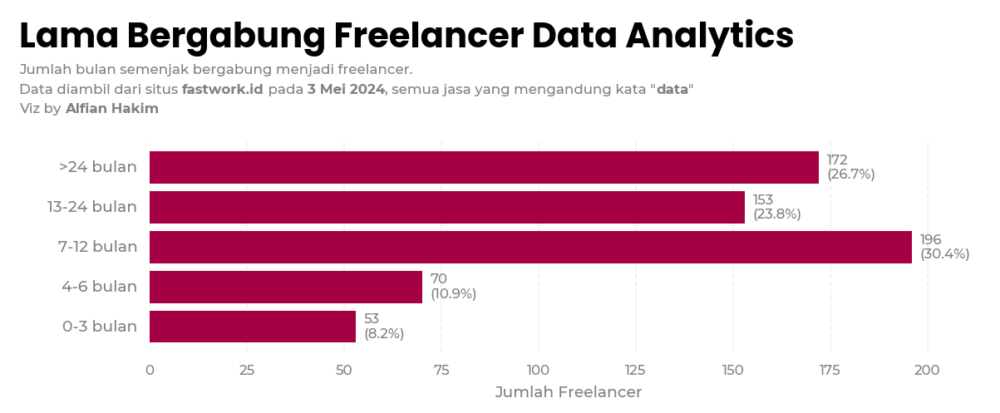

In [201]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars = ax1.barh(df_agg_tier['tier_join'], df_agg_tier['count'], color=b_colors[0])

_, xmax = ax1.get_xlim()

for bar in bars:
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{width:,}\n({width / df_agg_tier['count'].sum() * 100:.1f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c='grey', fontsize=8)



ax1.set_yticklabels(df_agg_tier['tier_join'].apply(lambda x:x[3:]), rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


x_min = 0
x_max = df_agg_tier['count'].max()*1.1

ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Jumlah Freelancer', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Lama Bergabung Freelancer Data Analytics',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Jumlah bulan semenjak bergabung menjadi freelancer.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


#### Viz Persentase Terjual

In [202]:
df_agg_tier['count_unsold'] = df_agg_tier['count']-df_agg_tier['count_sold']

for status in ['sold', 'unsold']:
    df_agg_tier[f'{status}_pct'] = df_agg_tier[f'count_{status}']/df_agg_tier['count']*100

df_agg_tier

,tier_join,count,count_sold,count_unsold,sold_pct,unsold_pct
0,1. 0-3 bulan,53,10,43,18.867925,81.132075
1,2. 4-6 bulan,70,8,62,11.428571,88.571429
2,3. 7-12 bulan,196,30,166,15.306122,84.693878
3,4. 13-24 bulan,153,48,105,31.372549,68.627451
4,5. >24 bulan,172,78,94,45.348837,54.651163


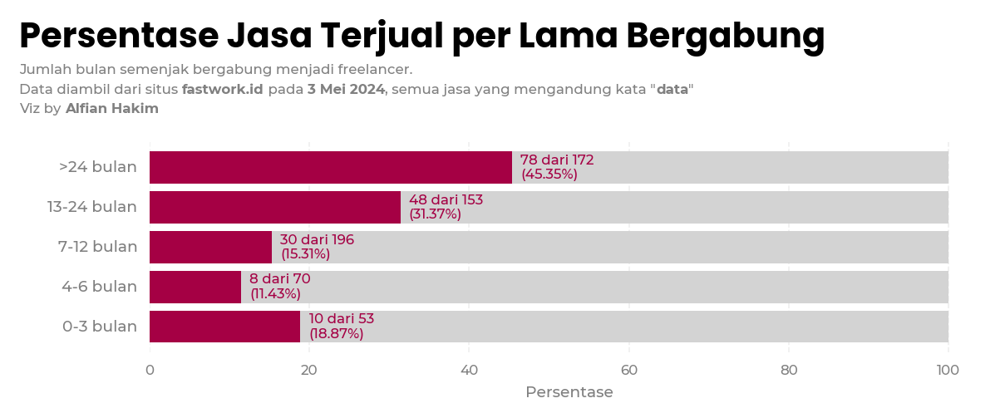

In [203]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(8, 3), dpi=150)

bars_1 = ax1.barh(df_agg_tier['tier_join'],
                  df_agg_tier['sold_pct'], color=b_colors[0])
bars_2 = ax1.barh(df_agg_tier['tier_join'], df_agg_tier['unsold_pct'],
                  left=df_agg_tier['sold_pct'], color='lightgray')

_, xmax = ax1.get_xlim()

for i, bar in enumerate(bars_1):
    width = bar.get_width()
    label_x = width+1/100*xmax  # Adjust the position of the label
    label_y = bar.get_y() + bar.get_height() / 2
    label_text = f"{df_agg_tier.iloc[i]['count_sold']:,} dari {df_agg_tier.iloc[i]['count']:,}\n({width:.2f}%)"
    ax1.text(label_x, label_y, label_text, ha='left', va='center', c=b_colors[0], fontsize=8)



ax1.set_yticklabels(df_agg_tier['tier_join'].apply(lambda x:x[3:]), rotation=0, ha='right',va='center',color='gray', fontsize=9)
ax1.tick_params(axis='x', labelsize=8)


# x_min = 0
# x_max = df_agg_category['count'].max()*1.1

# ax1.set_xlim(x_min, x_max)

# Add a grid
ax1.grid(True, axis='x', linestyle='--', alpha=0.2)
ax1.tick_params(bottom=False, left=False, colors='grey')
# ax1.tick_params(axis='y', colors='grey')
# ax1.tick_params(axis='x', colors='grey')
ax1.set_axisbelow(True)
# ax1.xaxis.grid(True, color='#EEEEEE')
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
# ax1.spines['left'].set_color('#DDDDDD')
# ax1.spines['bottom'].set_color('#DDDDDD')


ax1.set_xlabel('Persentase', labelpad=5, weight='medium', c='grey', fontsize=9)
fig_text(x = 0.01, y = 1-0.03,
         fontsize = 20,
        #  s = 'Distribusi Kategori<*> Servis Freelancer Data',
         s = 'Persentase Jasa Terjual per Lama Bergabung',
         color = 'black',
        #  highlight_textprops = [{"weight":"medium"}],
         highlight_textprops = [],
         font='Poppins',
         weight='bold',
         ha='left',
         va='bottom'
         )
fig_text(x = 0.01, y = 0.98-0.03,
         fontsize = 8,
         s = 'Jumlah bulan semenjak bergabung menjadi freelancer.\nData diambil dari situs <fastwork.id> pada <3 Mei 2024>, semua jasa yang mengandung kata "<data>"\nViz by <Alfian Hakim>',
         color = 'gray',
         highlight_textprops = [{"weight":"bold"},{"weight":"bold"},{"weight":"bold"}, {'weight':'bold'}],
        #  font='Poppins',
        #  weight='bold',
         ha='left',
         va='top'
         )

# Display the plot
plt.tight_layout()
plt.show()


- freelancer lama cenderung lebih banyak yg pernah terjual jasanya

### Universitas & Jurusan, Sertifikasi & Skill, Perusahaan & Role

- untuk standarisasi, jurusan; sertifikasi; dan role akan diterjemahkan ke bahasa inggris

In [204]:
df_profiles_analytics = df_profiles.loc[df_profiles['user'].isin(df_analytics['user'].unique())].reset_index(drop=True)

In [205]:
df_profiles_analytics['degrees_translated'] = df_profiles_analytics.fillna('').apply(lambda row: trans_to_en(row['degrees'].replace(';',' ; ')), axis=1)
df_profiles_analytics['previous_roles_translated'] = df_profiles_analytics.fillna('').apply(lambda row: trans_to_en(row['previous_roles'].replace(';',' ; ')), axis=1)
df_profiles_analytics['certifications_translated'] = df_profiles_analytics.fillna('').apply(lambda row: trans_to_en(row['certifications'].replace(';',' ; ')), axis=1)
df_profiles_analytics['skills_translated'] = df_profiles_analytics.fillna('').apply(lambda row: trans_to_en(row['skills'].replace(';',' ; ')), axis=1)

#### Viz Word Cloud Universitas & Jurusan

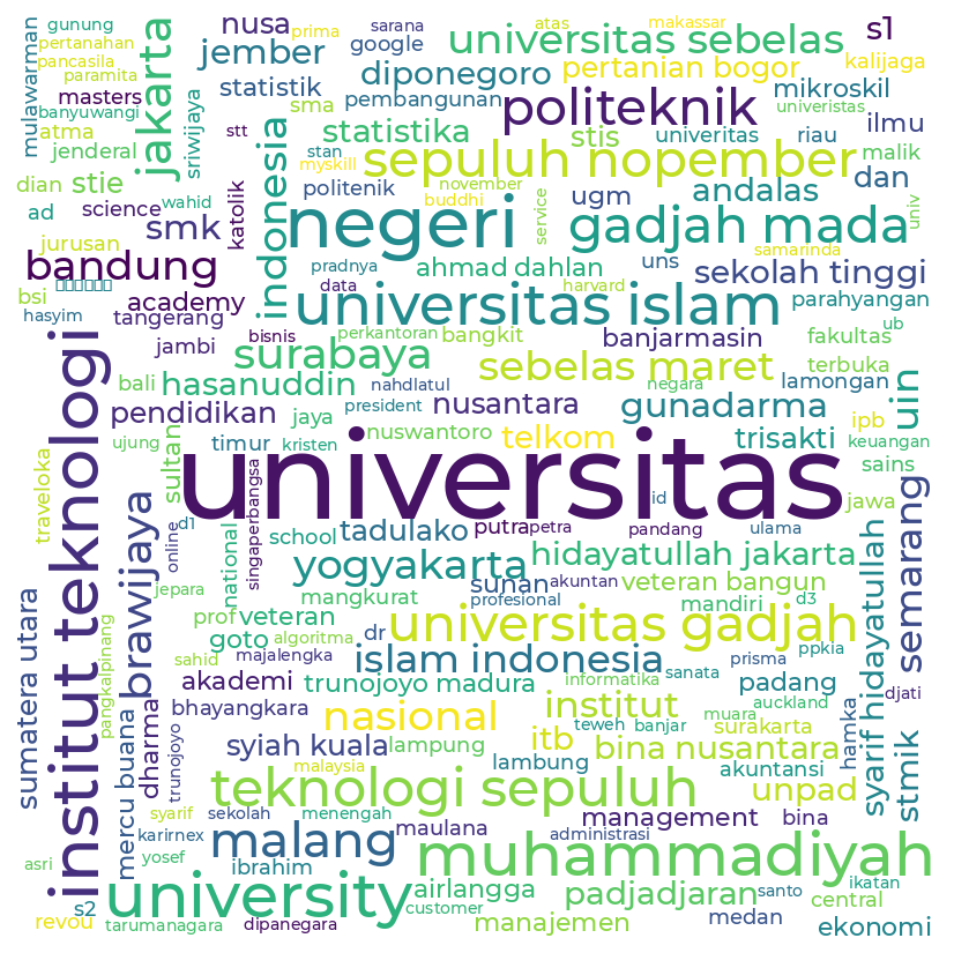

In [206]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_profiles_analytics.fillna('')['universities'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

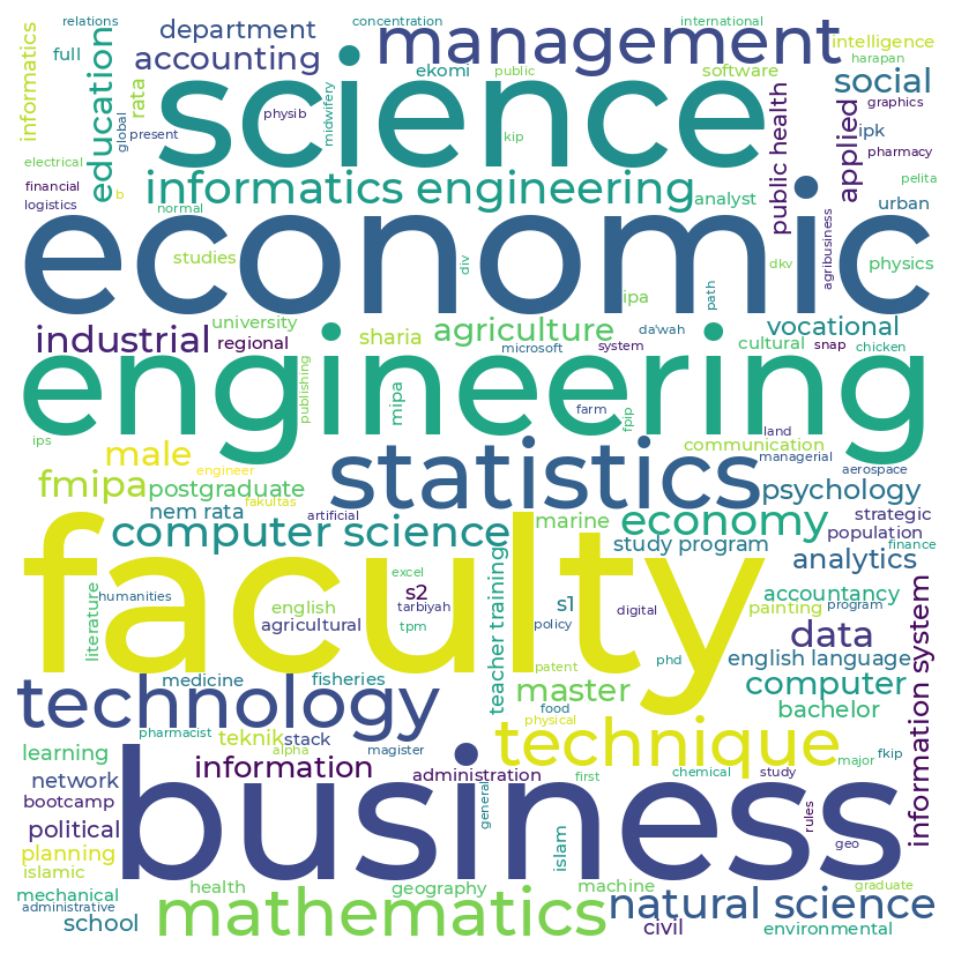

In [207]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_profiles_analytics.fillna('')['degrees_translated'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

In [215]:
x, y = np.ogrid[:800, :800]
mask = (x - 400) ** 2 + (y - 400) ** 2 > 480 ** 2
mask = 255 * mask.astype(int)

text_left = " ".join(df_profiles_analytics.fillna('')['universities'].apply(lambda x:x.lower()).tolist())

wc_left = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func("black")
  )
wc_left.generate(text_left)

text_right = " ".join(df_profiles_analytics['degrees_translated'].apply(lambda x:x.lower()).tolist())

wc_right = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func(b_colors[0])
  )
wc_right.generate(text_right)

(0.0, 8.0, 0.0, 4.5)

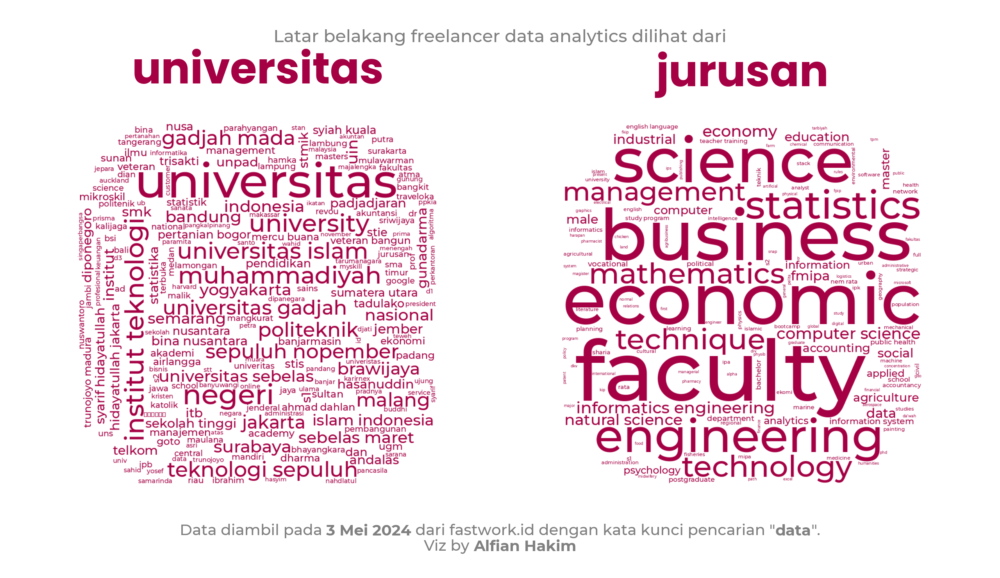

In [219]:
fig, ax = plt.subplots(figsize=(8,4.5), dpi=400)

ax.set_xlim(0, 8)
ax.set_ylim(0, 4.5)

# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([0.5, 0.5])
ax_point_2 = DC_to_NFC([3.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([0.5, 0.6])

left_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

left_ax.axis("off")
left_ax.imshow(wc_left, interpolation = "bilinear")


# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([4.5, 0.5])
ax_point_2 = DC_to_NFC([7.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([4.5, 0.6])

right_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

right_ax.axis("off")
right_ax.imshow(wc_right, interpolation = "bilinear")

ax.annotate(
    xy=(4, 4.25),
    text="Latar belakang freelancer data analytics dilihat dari",
    ha='center',
    va='bottom',
    color='gray',
    fontsize = 8,
    # font="Poppins",
    weight="medium"
)

ax_text(x=2, y= 4.2,
                       s = '<universitas>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 4.2,
                       s = '<jurusan>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)


ax_text(x=4, y= 0.15,
                       s = 'Data diambil pada <3 Mei 2024> dari fastwork.id dengan kata kunci pencarian "<data>".',
                       highlight_textprops = [
                           {"weight":"bold"},
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='bottom', weight="medium",
                       ax=ax)

ax_text(x=4, y= 0.14,
                       s = 'Viz by <Alfian Hakim>',
                       highlight_textprops = [
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='top', weight="medium",
                       ax=ax)

ax.axis("off")

- banyak lulusan dari jurusan teknik, ekonomi, matematika, bisnis, sains
- banyak dari ugm, its, ub, uin, uns

#### Viz Word Cloud Sertifikasi & Skill

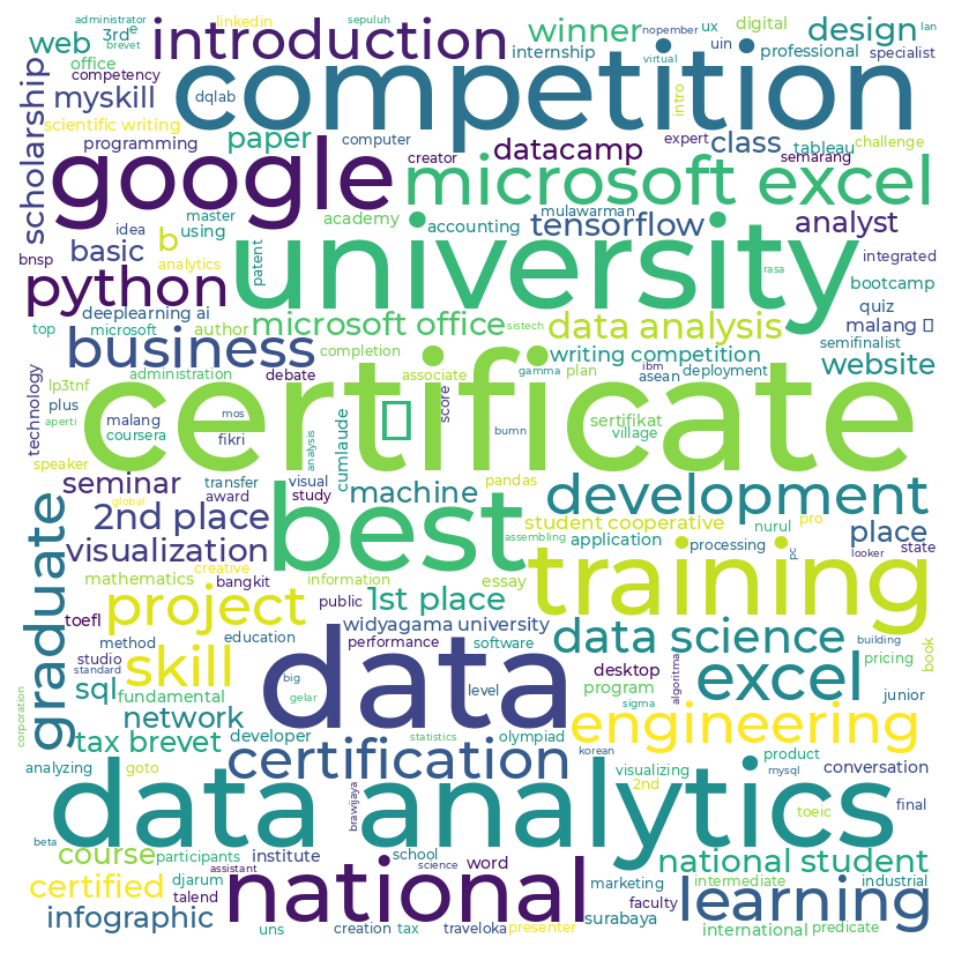

In [208]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_profiles_analytics.fillna('')['certifications_translated'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

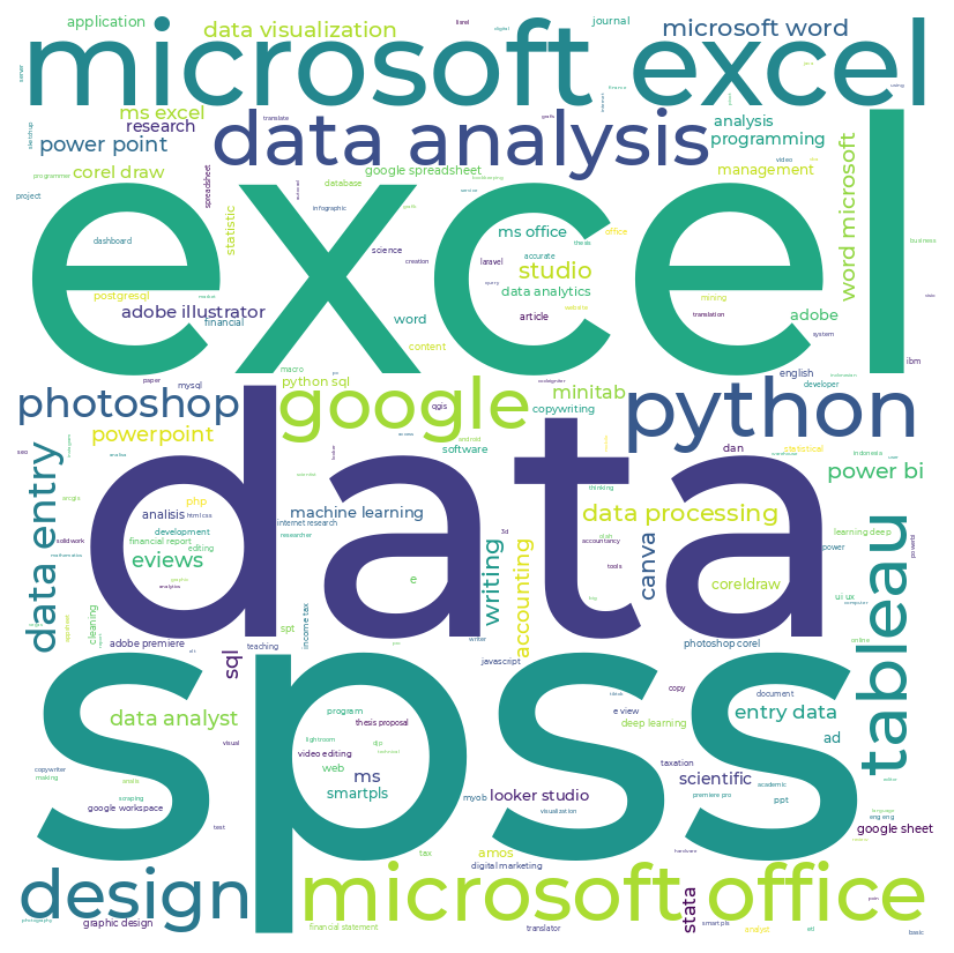

In [211]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_profiles_analytics.fillna('')['skills_translated'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

In [221]:
x, y = np.ogrid[:800, :800]
mask = (x - 400) ** 2 + (y - 400) ** 2 > 480 ** 2
mask = 255 * mask.astype(int)

text_left = " ".join(df_profiles_analytics.fillna('')['certifications_translated'].apply(lambda x:x.lower()).tolist())

wc_left = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func("black")
  )
wc_left.generate(text_left)

text_right = " ".join(df_profiles_analytics['skills_translated'].apply(lambda x:x.lower()).tolist())

wc_right = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func(b_colors[0])
  )
wc_right.generate(text_right)

(0.0, 8.0, 0.0, 4.5)

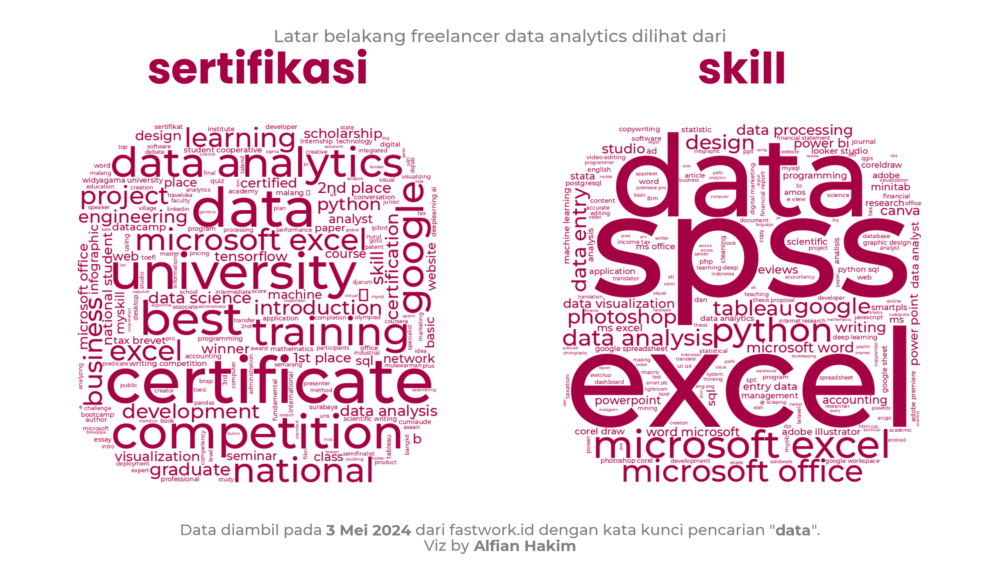

In [222]:
fig, ax = plt.subplots(figsize=(8,4.5), dpi=400)

ax.set_xlim(0, 8)
ax.set_ylim(0, 4.5)

# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([0.5, 0.5])
ax_point_2 = DC_to_NFC([3.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([0.5, 0.6])

left_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

left_ax.axis("off")
left_ax.imshow(wc_left, interpolation = "bilinear")


# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([4.5, 0.5])
ax_point_2 = DC_to_NFC([7.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([4.5, 0.6])

right_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

right_ax.axis("off")
right_ax.imshow(wc_right, interpolation = "bilinear")

ax.annotate(
    xy=(4, 4.25),
    text="Latar belakang freelancer data analytics dilihat dari",
    ha='center',
    va='bottom',
    color='gray',
    fontsize = 8,
    # font="Poppins",
    weight="medium"
)

ax_text(x=2, y= 4.2,
                       s = '<sertifikasi>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 4.2,
                       s = '<skill>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)


ax_text(x=4, y= 0.15,
                       s = 'Data diambil pada <3 Mei 2024> dari fastwork.id dengan kata kunci pencarian "<data>".',
                       highlight_textprops = [
                           {"weight":"bold"},
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='bottom', weight="medium",
                       ax=ax)

ax_text(x=4, y= 0.14,
                       s = 'Viz by <Alfian Hakim>',
                       highlight_textprops = [
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='top', weight="medium",
                       ax=ax)

ax.axis("off")

- spss dan excel termasuk skill yg paling banyak muncul

#### Viz Word Cloud Perusahaan & Role

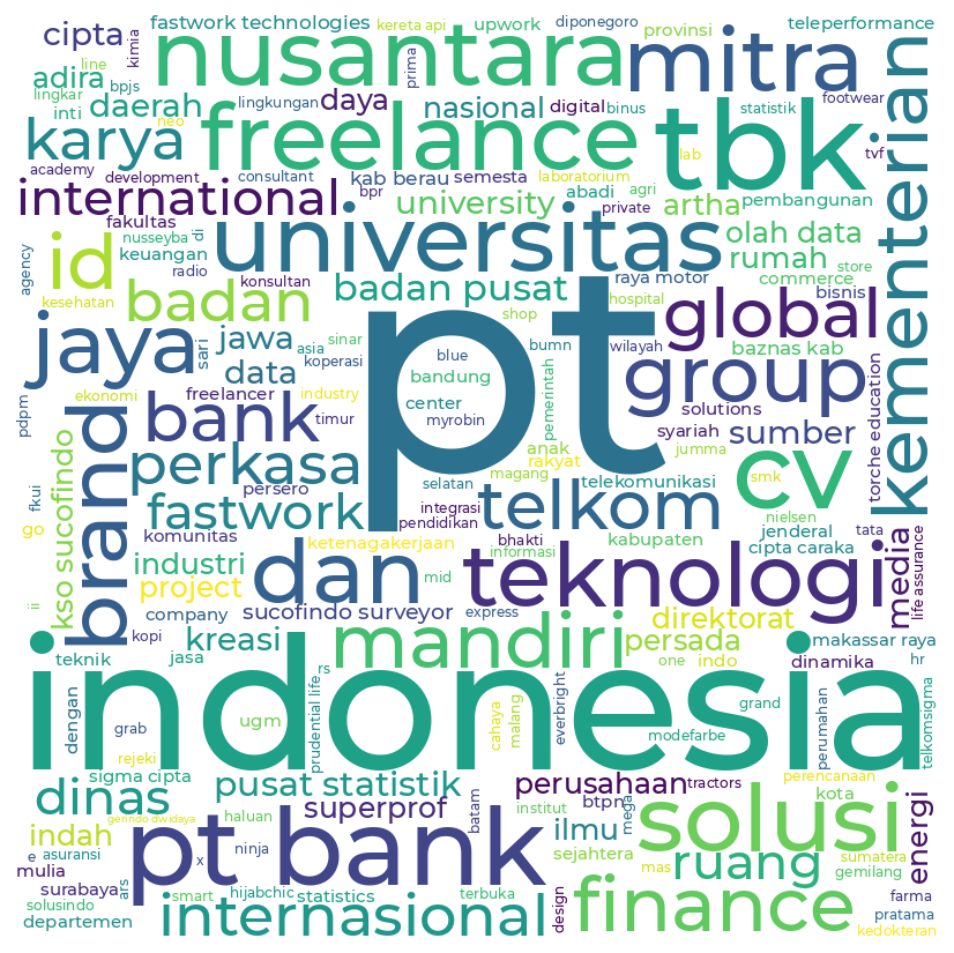

In [212]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_profiles_analytics.fillna('')['previous_companies'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

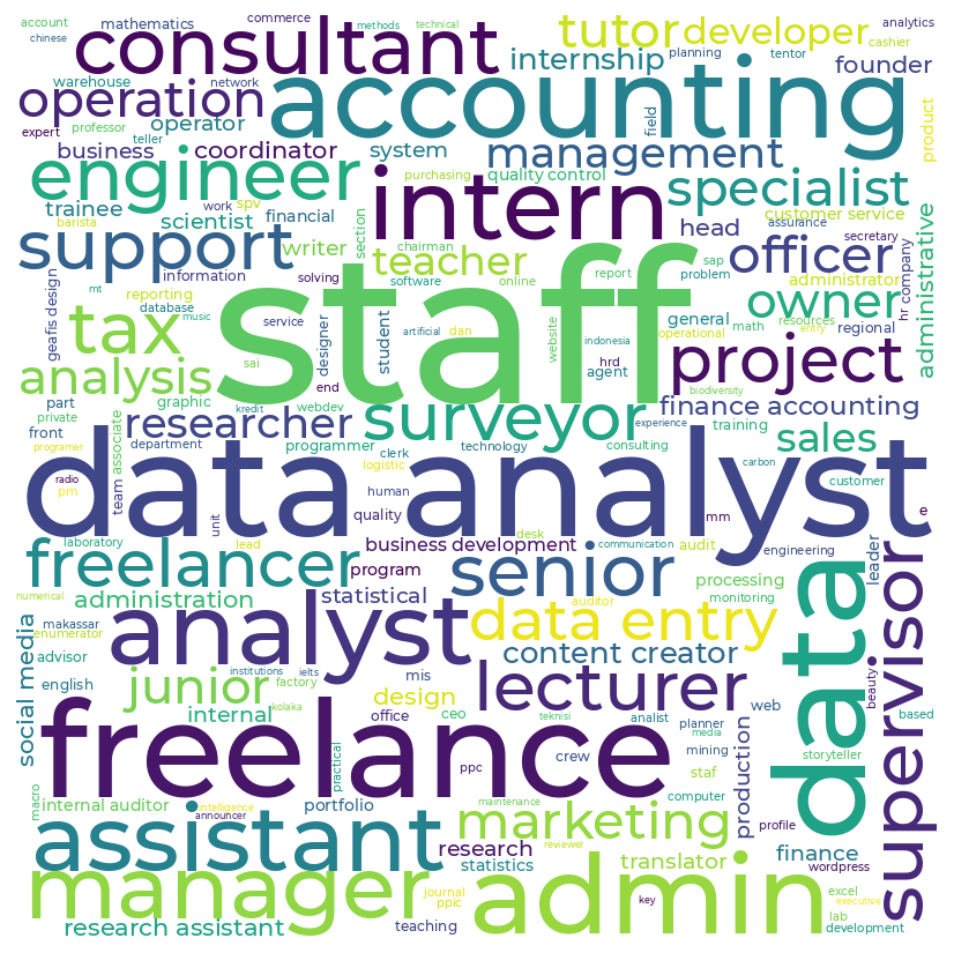

In [213]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, get_single_color_func

# text = "Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat"
text = " ".join(df_profiles_analytics.fillna('')['previous_roles_translated'].apply(lambda x:x.lower()).tolist())

wc = WordCloud(width = 800, height = 800, background_color = "white", font_path="Montserrat-Medium.ttf")
wc.generate(text)

fig, ax = plt.subplots(figsize=(8,8), dpi=150)

ax.axis("off")
ax.imshow(wc, interpolation = "bilinear")

In [223]:
x, y = np.ogrid[:800, :800]
mask = (x - 400) ** 2 + (y - 400) ** 2 > 480 ** 2
mask = 255 * mask.astype(int)

text_left = " ".join(df_profiles_analytics.fillna('')['previous_companies'].apply(lambda x:x.lower()).tolist())

wc_left = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func("black")
  )
wc_left.generate(text_left)

text_right = " ".join(df_profiles_analytics['previous_roles_translated'].apply(lambda x:x.lower()).tolist())

wc_right = WordCloud(
  # width = 800, height = 800,
  mask=mask,
  background_color = "white",
  # max_words=50,
  font_path="Montserrat-Medium.ttf",
  color_func=lambda *args, **kwargs: b_colors[0]
  # color_func=get_single_color_func(b_colors[0])
  )
wc_right.generate(text_right)

(0.0, 8.0, 0.0, 4.5)

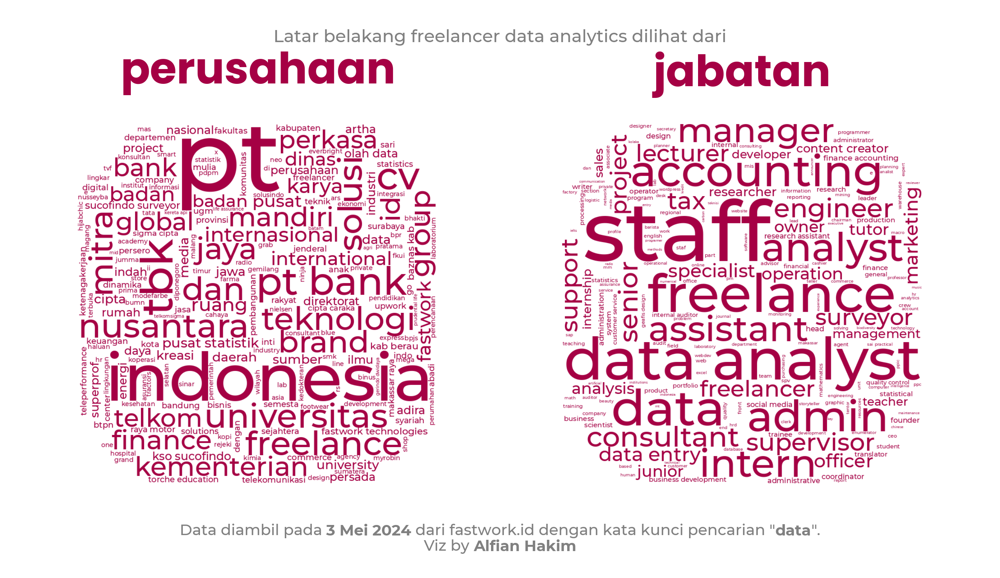

In [224]:
fig, ax = plt.subplots(figsize=(8,4.5), dpi=400)

ax.set_xlim(0, 8)
ax.set_ylim(0, 4.5)

# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([0.5, 0.5])
ax_point_2 = DC_to_NFC([3.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([0.5, 0.6])

left_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

left_ax.axis("off")
left_ax.imshow(wc_left, interpolation = "bilinear")


# -- Transformation functions
DC_to_FC = ax.transData.transform
FC_to_NFC = fig.transFigure.inverted().transform
# -- Take data coordinates and transform them to normalized figure coordinates
DC_to_NFC = lambda x: FC_to_NFC(DC_to_FC(x))
# -- Add nation axes
ax_point_1 = DC_to_NFC([4.5, 0.5])
ax_point_2 = DC_to_NFC([7.5, 3.5])
ax_width = abs(ax_point_1[0] - ax_point_2[0])
ax_height = abs(ax_point_1[1] - ax_point_2[1])

ax_coords = DC_to_NFC([4.5, 0.6])

right_ax = fig.add_axes(
    [ax_coords[0], ax_coords[1], ax_width, ax_height]
)

right_ax.axis("off")
right_ax.imshow(wc_right, interpolation = "bilinear")

ax.annotate(
    xy=(4, 4.25),
    text="Latar belakang freelancer data analytics dilihat dari",
    ha='center',
    va='bottom',
    color='gray',
    fontsize = 8,
    # font="Poppins",
    weight="medium"
)

ax_text(x=2, y= 4.2,
                       s = '<perusahaan>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)

ax_text(x=6, y= 4.2,
                       s = '<jabatan>',
                       highlight_textprops = [
                           {"weight":"bold", "font":"Poppins"}
                       ],
                        fontsize = 20,
                        color = b_colors[0],
                        ha='center', va='top',
        font="Poppins",
        weight="medium",
                       ax=ax)


ax_text(x=4, y= 0.15,
                       s = 'Data diambil pada <3 Mei 2024> dari fastwork.id dengan kata kunci pencarian "<data>".',
                       highlight_textprops = [
                           {"weight":"bold"},
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='bottom', weight="medium",
                       ax=ax)

ax_text(x=4, y= 0.14,
                       s = 'Viz by <Alfian Hakim>',
                       highlight_textprops = [
                           {"weight":"bold"}
                       ],
                        fontsize = 7,
                        color = 'gray',
                        ha='center', va='top', weight="medium",
                       ax=ax)

ax.axis("off")

- ada freelancer yang bekerja di kementerian, bps (pusat statistik), bank
- banyak freelancer bertitel data analyst, ada yg jabatannya manager, ada juga guru dan dosen